# Environment setup

In [1]:
from scipy.io import loadmat
import os
import numpy as np
import mne
import matplotlib.pyplot as plt

# Path to musicImagery dataset
dataDir = r'../../data/musicImagery/'
#dataDir = r'D:\marion_music_imagery\datasetCND_musicImagery\musicImagery'

In [2]:
%matplotlib widget

In [3]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

// This disables scrolling outputs

<IPython.core.display.Javascript object>

# Load stimuli
Note: ```stimIndxs``` range from 1 to 4 and ```condIdxs``` range from 1-2.
These are _not_ 0-indexed.

In [4]:
stim_mat = loadmat(dataDir+r"/dataCND/dataStim.mat", simplify_cells = True) 
stim = stim_mat['stim']
# print(stim)

stimIdxs = stim['stimIdxs']
print(f'stimIdxs shape (N trials): {stimIdxs.shape}')

condIdxs = stim['condIdxs']
print(f'condIdxs shape (N trials): {condIdxs.shape}')

condNames = stim['condNames']
print(f'condNames shape (P conditions): {condNames.shape}')

stim_events = stim['data']
print(f'events shape (M features, N trials): {stim_events.shape}')

stim_event_labels = stim['names']
print(f'event names shape (M features): {stim_event_labels.shape}')

fs_stim = stim['fs'] # ignore, use fs from data struct (64 Hz)
print(f'fs: {fs_stim} Hz')

stimIdxs shape (N trials): (88,)
condIdxs shape (N trials): (88,)
condNames shape (P conditions): (2,)
events shape (M features, N trials): (2, 88)
event names shape (M features): (2,)
fs: 64 Hz


In [5]:
# Handy mapping of indices to labels
stimId_to_Song_map = {
    2: 'chor-038', 
    1: 'chor-096', 
    3: 'chor-101',
    4: 'chor-019', 
} # from read_stim_midi.ipynb

stimLabel_to_id_map = {
    'chor-038': 2, 
    'chor-096': 1, 
    'chor-101': 3,
    'chor-019': 4, 
} # reverse mapping

stimLabel_to_sheet_order_map = {
    'chor-038': 1, 
    'chor-096': 2, 
    'chor-101': 3,
    'chor-019': 4, 
} # order of songs on sheet music

condId_to_State_map = {
    1: 'Listening', 
    2: 'Imagery'
} # from condNames

# Stim Channel

Finding tactile metronome onsets

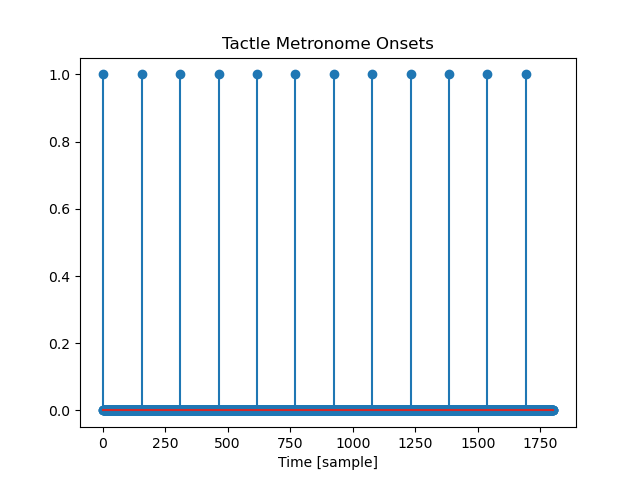

In [6]:
# From Guilhem's note
barOnsets = [1, 157] # in sample indices

cueTime = 310 # third bar
for barIdx in range(10): # 12 bars total
    barOnsets.append(cueTime)
    if barIdx%2 == 1:
        cueTime += 153
    else:
        cueTime += 154
        
cueTime -= 1 # index from 0

# Make a new exp vector for metronome hits
cueExp = np.zeros_like(stim_events[1][0]) # same size as the first expectation vector
cueExp[barOnsets] = 1

plt.figure()
plt.stem(cueExp, '*')
plt.xlabel('Time [sample]')
plt.title('Tactle Metronome Onsets')
plt.show()

Note onsets for stim channel

In [7]:
stim = {}
for stimLabel in [
    'chor-038', 
    'chor-096', 
    'chor-101',
    'chor-019']: # top to bottom on the sheet music

    stim[stimLabel] = {}
    
    # Collect note and beat onsets for current stim
    stimIdx = stimLabel_to_id_map[stimLabel]
    stimExp = stim_events[1][11*(stimIdx-1)] # expectations vector for current stim
    note_onsets = stimExp > 0
    stim[stimLabel]['notes'] = note_onsets
    stim[stimLabel]['beats'] = cueExp

These indices will be used later to identify song and condition for a given subject's trial order:

In [8]:
# Collect stim idxs by condition and song
idxs = {} # dict to store idxs for each condition and stim/song idx

for condIdx in np.unique(condIdxs): # two conditions
    condName = condNames[condIdx-1] # MATLAB indexes from 1...
    idxs[condName] = {}
    
    for stimIdx in np.unique(stimIdxs):
        
        stimName = stimId_to_Song_map[stimIdx]
        
        print(f'{condName}: Song {stimName}: Indices:') 
        matched_ndx = np.where(
            (stimIdxs == stimIdx) & (condIdxs == condIdx)
            )[0]
        print(matched_ndx)
        
        idxs[condName][stimName] = matched_ndx

Listening: Song chor-096: Indices:
[ 0  1  2  3  4  5  6  7  8  9 10]
Listening: Song chor-038: Indices:
[11 12 13 14 15 16 17 18 19 20 21]
Listening: Song chor-101: Indices:
[22 23 24 25 26 27 28 29 30 31 32]
Listening: Song chor-019: Indices:
[33 34 35 36 37 38 39 40 41 42 43]
Imagery: Song chor-096: Indices:
[44 45 46 47 48 49 50 51 52 53 54]
Imagery: Song chor-038: Indices:
[55 56 57 58 59 60 61 62 63 64 65]
Imagery: Song chor-101: Indices:
[66 67 68 69 70 71 72 73 74 75 76]
Imagery: Song chor-019: Indices:
[77 78 79 80 81 82 83 84 85 86 87]


# Load EEG data for a subject

Make a list of raws for each subject, in original trial order

Steps needed:
- Make an MNE info object
    - Add trial condition and song name to raw's description
- Correct channel names for applying biosemi64 montage
- Add a stim channel with note and beat onsets 
    - Note, there are no overlapping events as any notes overlapped with beat onsets are removed from the stim mat files (these can still be recovered from the MIDI if needed)

In [9]:
def all_raws_for_subject(
        subjectID = 1,
        BEAT_EVENT_MARKER = 1,
        NOTE_EVENT_MARKER = 128,
    ):
    
    # Path to data for selected subject
    sub1_mat = loadmat(dataDir+f"/dataCND/dataSub{subjectID}.mat", simplify_cells = True) 

    # This should be the same as fs_stim above
    fs = sub1_mat['eeg']['fs']

    # EEG dataset for selected subject
    data = sub1_mat['eeg']['data']

    # Randomized trial order for current subject
    orig_trial_pos = sub1_mat['eeg']['origTrialPosition']
    #print(f'orig_trial_pos: {orig_trial_pos}')

    # Get current subject's song and condition ordering (since its randomized)
    thisSubStimOrder = stimIdxs[(orig_trial_pos-1)] # convert to being zero indexed
    thisSubCondOrder = condIdxs[(orig_trial_pos-1)]

    # EEG channel map
    chanLocs = sub1_mat['eeg']['chanlocs']
    montage_chs = [] # get channel names and order from chanLocs
    for k in chanLocs:
        ch_n = k['labels'].split(' (')[0] # remove paranthesis from name
        montage_chs.append(ch_n)

    # Make an info object
    info = mne.create_info(
            ch_names=montage_chs + ['midi'], 
            sfreq=fs, 
            ch_types=['eeg']*len(chanLocs) + ['stim']
        )
    info.set_montage('biosemi64', match_case=False) # resolves Afz case trouble

    raw_trials = []
    for trialIdx in orig_trial_pos-1: # go back to original trial order

        # What stim and condition (state) is this trial?
        stimIdx = thisSubStimOrder[trialIdx]
        condIdx = thisSubCondOrder[trialIdx]

        info['description'] = str(trialIdx) #f'{condId_to_State_map[condIdx]}/{stimId_to_Song_map[stimIdx]}'
        
        stimLabel = stimId_to_Song_map[stimIdx]
        stim_data = NOTE_EVENT_MARKER * stim[stimLabel]['notes'] + BEAT_EVENT_MARKER * stim[stimLabel]['beats']
        #print(stim_data.shape)
        #print(data[trialIdx].shape)

        # Rescale data to Volts, Add the stim channel
        eeg_and_stim_data = np.vstack((data[trialIdx].T / 1e6, stim_data))
        
        raw = mne.io.RawArray(
            data = eeg_and_stim_data, # transpose for importing to MNE
            info = info,
            verbose = 'ERROR',
        )

        raw_trials.append(raw)

    return raw_trials

def merged_raws_for_subject(subjectID):
    
    # Collect a list of raws per subject
    raw_trials = all_raws_for_subject(subjectID = subjectID)
    #print(len(raw_trials))

    # Now concatenate these raws
    for raw in raw_trials:
        trialIdx = int(raw.info['description'])
        stimLabel = stimId_to_Song_map[stimIdxs[trialIdx]]
        condLabel = condId_to_State_map[condIdxs[trialIdx]]
        #print(f"sub{subjectID}\ttrial #{raw.info['description']}\t{condLabel}\t{stimLabel}")

        # https://mne.tools/stable/auto_tutorials/raw/30_annotate_raw.html
        trial_annot = mne.Annotations(
            onset = [0],
            duration = raw[0][-1][-1], # entire duration of the trial
            description = f'{condLabel}/{stimLabel}'
        )

        raw.set_annotations(trial_annot)

    return mne.concatenate_raws(raw_trials)

List of raws, in original trial order, by subject

In [10]:
from collections import OrderedDict

Only run this cell once after the cell above?

In [11]:
# Collect merged raws per subject
merged_raw_trials = OrderedDict()

for subjectID in [1, 3, 7, 11]:
    merged_raw_trials[subjectID] = merged_raws_for_subject(subjectID)

Using matplotlib as 2D backend.


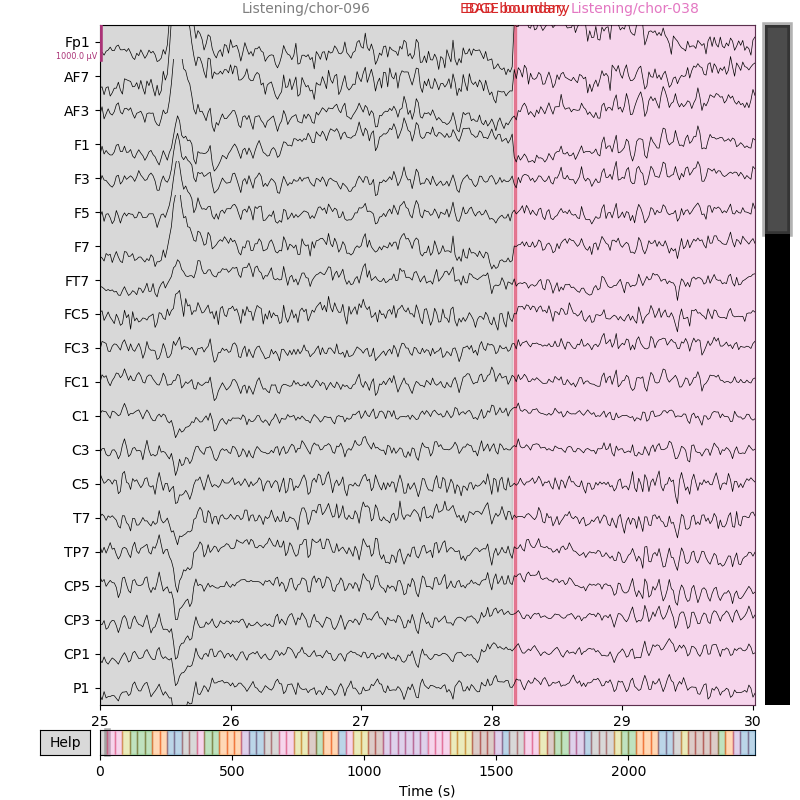

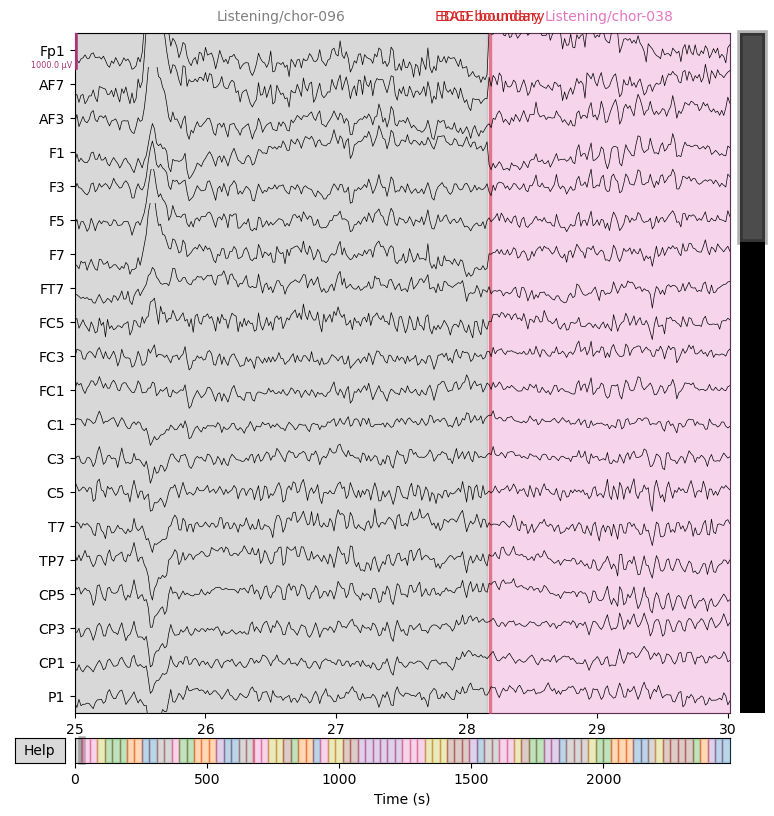

In [12]:
merged_raw_trials[subjectID].plot(
    duration = 5,
    start = 25,
    scalings = {'eeg': 500e-6}
)

In [13]:
merged_raw_trials[subjectID]

Measurement date,Unknown
Experimenter,Unknown
Participant,Unknown
Digitized points,67 points
Good channels,"64 EEG, 1 Stimulus"
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,64.00 Hz
Highpass,0.00 Hz
Lowpass,32.00 Hz


# Plot ICs for 11 trials for same condition / song / subject

In [14]:
def get_eps_idx_matching_condition(eps, condition):
    
    trial_order = []
    for i in range(88):
        ep = eps[i]
        this_ep_event_id = eps[i].event_id
        #print(this_ep_event_id)
        
        if condition in this_ep_event_id.keys():
            trial_order.append(i)
    
    return trial_order

In [15]:
if 0: # skip running ICA again
    tmin = 0
    tmax = 28 # to avoid dropping epochs from major movements towards end of trials
    eog_filter = False
    common_average = False
    condition = 'Listening/chor-038'
    SPECTRUM_YLIMS = [-25, 25]
    VARIANCE_YLIMS = [0, 3]

    for subjectID in [1]:

        raw = merged_raw_trials[subjectID].copy()
        raw.n_times
        raw.tmax

        if eog_filter:
            raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
                l_freq=1, 
                h_freq=10,
            )
            #mne.viz.plot_montage(raw.info.get_montage())
        else:
            raw_filt = raw
            
        if common_average:
            raw_filt.set_eeg_reference('average')

        # Get conditions from events
        events, event_id = mne.events_from_annotations(raw_filt)
        #print(events)
        print(event_id)

        eps = mne.Epochs(
            raw=raw_filt,
            events=events,
            event_id=event_id,
            tmin=tmin,
            tmax=tmax,
            baseline=None,
        )
        print(eps)

        #for condition in ['Listening/chor-038']:

        eps[condition].plot(
            scalings = {'eeg': 500e-6}
        )

        ica = mne.preprocessing.ICA(
            n_components = 63,
            # method='infomax', # needed by ica-label, but takes longer to run than fastica (default)
        )

        # Fit ICA only on epochs matching this one subject and given condition
        ica.fit(
            eps[condition],
            reject = None,
            reject_by_annotation=False,
        )
        #ica_sources = ica.apply(raw_filt)

        # assuming you have a Raw and ICA instance previously fitted
        # label_components(raw_filt, ica, method='iclabel')

        ica.plot_sources(eps[condition])

        for ica_chan in [0, 1]:
            fig = ica.plot_properties(
                eps[condition], #[:-1], # because one epoch got dropped?
                picks = [ica_chan],
                #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
            )

            print(fig[0].get_axes())
            for ax in fig[0].get_axes():
                if ax.get_label() == 'topomap':
                    title_str = f"Subject {subjectID}, {', '.join(condition.split('/'))}\n{ax.get_title()}"
                    if ax.get_title() == 'ICA000':
                        title_str += " (Eye Blinks)"
                    elif ax.get_title() == 'ICA001':
                        title_str += " (Eye Sweeps)"
                    ax.set_title(title_str)

                if ax.get_label() == 'image':
                    ax.set_title('Trials (as epochs): image and ERP/ERF')
                    ax.set_ylabel('Trial #') # from epochs
                    ax.set_xticks([])
                    ax.set_xticklabels('') # hide major tick labels
                    ax.set_yticks([])
                    ax.set_ylim([0, 11])
                    ax.set_yticklabels('') # hide major tick labels
                    ax.set_yticks(
                        [y + 0.5 for y in range(0, 11)], 
                        minor=True,
                        ) # https://stackoverflow.com/questions/17158382/centering-x-tick-labels-between-tick-marks-in-matplotlib
                    ax.set_yticklabels(
                        get_eps_idx_matching_condition(eps, condition), 
                        minor=True,
                    )

                if ax.get_label() == 'spectrum':
                    ax.set_ylim(SPECTRUM_YLIMS)

                if ax.get_label() == 'erp':
                    #ax.get_shared_x_axes().remove(ax) # unlink x-axis from 'image' axis # deprecated?
                    ax.set_xticks([tmin, tmax])
                    ax.set_xticklabels([None, tmax])
                    #ax.set_yticklabels('') # hide major tick labels
                
                if ax.get_label() == 'variance':
                    #ax.set_title('Trials (epochs) image and ERP/ERF')
                    ax.set_xlabel('Trial #') # from epochs
                    ax.set_xticks([])
                    ax.set_xticklabels('') # hide major tick labels
                    ax.set_xticks(
                        [x for x in range(11)], 
                        #minor=True,
                        ) # https://stackoverflow.com/questions/17158382/centering-x-tick-labels-between-tick-marks-in-matplotlib
                    ax.set_xticklabels(
                        get_eps_idx_matching_condition(eps, condition), 
                        #minor=True,
                    )
                    ax.set_ylim(VARIANCE_YLIMS)

            #fig[0].suptitle(f'Subject {subjectID} {condition}')
            plt.tight_layout()
            if 'Eye Blinks' in title_str:
                fig[0].savefig('ica_eye_blinks.svg', format='svg', dpi=300)
            elif 'Eye Sweeps' in title_str:
                fig[0].savefig('ica_eye_sweeps.svg', format='svg', dpi=300)

    #plt.show()

Experiment updating axes parameters:

In [16]:
if 0:
    print(fig[0].get_axes())

    for ax in fig[0].get_axes():

        if ax.get_label() == 'topomap':
            ax.set_title(ax.get_title() + ' (Blinks)')

        if ax.get_label() == 'image':
            ax.set_title('Trials (epochs) image and ERP/ERF')
            ax.set_ylabel('Trials') # from epochs
            ax.set_yticks(range(1, 11+1))
            ax.set_yticklabels(range(1, 11+1))
            print(ax.get_shared_x_axes())
            ax.sharex = False
            print(ax._sharex)
            ax._sharex = None
            print(ax._sharex)

        if ax.get_label() == 'erp':
            print(ax._sharex)
            print(dir(ax.get_shared_x_axes()))
            #print(ax.get_shared_x_axes().clean()) # deprecated
            #print(ax.get_shared_x_axes().get_siblings(ax)) # deprecated

        fig[0].suptitle('Subject')

    plt.show()

## EOG events from ICA source

### Run ICA on all epochs (trials) at once, takes ~3 mins per subject 

In [17]:
if 0:
    # from mne_icalabel import label_components

    ica_all_trials = mne.preprocessing.ICA(
        n_components = 63,
        # method='infomax', # needed by ica-label, but takes longer to run than fastica (default)
    )

    # Fit ICA on ALL epochs (trials) for this one subject
    ica_all_trials.fit(
        raw, #[condition],
        reject = None,
        reject_by_annotation=False,
    )

In [18]:
if 0:
    for ica_chan in [0, 1, 2, 3, 4]:
        ica_all_trials.plot_properties(
            eps, # because one epoch got dropped?
            picks = [ica_chan],
            #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
        )
        plt.show()

Note: eye sweeps form two groups as some chorales had 8 bars and not 9...

# (skip) Reject epochs that could otherwise dominate the ICA plots...


Could just add a reject criterion to ica.fit()?

Instead trying to reject epochs using standard deviation of channel voltage in time domain...

In [19]:
if 0:
    # Flatten the data to get standard deviation
    raw_filt._data[:-1, :].shape # ignore the stim channel
    raw_filt_flat = raw_filt._data[:-1, :].flatten()
    raw_filt_flat.sort()

    std = np.std(raw_filt_flat[:int(.95*len(raw_filt_flat))])
    std = np.std(raw_filt_flat) #[:int(.95*len(raw_filt_flat))])
    print(std)
    plt.hist(raw_filt_flat, bins=1000)

    # Use the standard deviation as rejection criterion (scale a lot to keep eye blinks -- and most epochs)
    eps_rej = mne.Epochs(
        raw=raw_filt,
        events=events,
        event_id=event_id,
        tmin=tmin,
        tmax=tmax,
        baseline=None,
        reject={'eeg': 20*std}, #{'eeg': 15e-3},
        preload = True,
    )
    #print(eps_rej)
    eps_rej.plot_drop_log()

    # Visualize how bad the dropped epochs really are...
    drop_log = eps_rej.drop_log
    bad_epochs_idx = []
    for i in range(len(drop_log)):
        if drop_log[i] != ():
            bad_epochs_idx.append(i)

    for i in range(len(drop_log)):
        if not (i in bad_epochs_idx):
            bad_epochs_idx.append(i) # add a good epoch to the end for comparison
            break

    eps[bad_epochs_idx].plot(
        butterfly=True,
        scalings = {'eeg':10e-3}
    )
    plt.show()

    # See if ICA plotting looks better now...
    for ica_chan in [0, 1, 2, 3]:
        ica.plot_properties(
            eps_rej, # because one epoch got dropped?
            picks = [ica_chan],
            #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
        )
        plt.show()

# Score similarity between IC and frontal scalp channels

Interestingly this missed the eye sweep component.

In [20]:
if 0:
    # https://mne.tools/stable/auto_tutorials/preprocessing/40_artifact_correction_ica.html#using-an-eog-channel-to-select-ica-components

    # find which ICs match the EOG pattern
    eog_indices, eog_scores = ica_all_trials.find_bads_eog(
        #eps_rej,#raw_filt,
        raw,
        # skip filtering again since we are already using 1-10Hz BPF
        l_freq = None, 
        h_freq = None, 
        ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    )

    print(eog_indices, eog_scores)

# Manually identify ICA source with blinks / sweeps

In [21]:
BLINK_IC_IDX = 0

In [22]:
if 0:
    %matplotlib widget

    ica_eog_event_id = 3

    eog_filter = False
    common_average = False

    if eog_filter:
        raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
            l_freq=1, 
            h_freq=10,
        )
        #mne.viz.plot_montage(raw.info.get_montage())
    else:
        raw_filt = raw
        
    if common_average:
        raw_filt.set_eeg_reference('average')

    '''
    # Can't use epochs:
    ica_eog_events = mne.preprocessing.ica_find_eog_events(
        eps,
        eog_source = eog_src.get_data()[:, BLINK_IC_IDX, :], #eog_src[0][0],
        event_id = ica_eog_event_id,
        #ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    )
    '''
    print(raw_filt)
    print(ica_all_trials.get_sources(raw_filt)) # does not take RawArray, just gets first raw...

Instead, make eps again, now using complete trial duration (do not truncate each epoch in eps at 28s)

In [23]:
if 0:
    raws = all_raws_for_subject(subjectID)
    raws[0].tmax

    # Make epochs again, now with the full trial duration 
    eps_full = mne.Epochs(
        raw=raw_filt,
        events=events,
        event_id=event_id,
        tmin=0,
        tmax=raws[0].tmax, #raw_filt.tmax gives the total duration for all trials!
        baseline=None,
    )
    print(eps_full)

    eog_src = ica_all_trials.get_sources(
        eps_full,
    ).get_data()[:, BLINK_IC_IDX, :].flatten() #[BLINK_IC_IDX, :]

    print(eog_src.shape)

    ica_eog_events = mne.preprocessing.ica_find_eog_events(
        raw_filt,
        eog_source = eog_src, #eog_src[0][0],
        event_id = ica_eog_event_id,
        #ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    )

    ica_eog_annots = mne.annotations_from_events(
        ica_eog_events,
        sfreq = raw.info['sfreq'],
        event_desc = {ica_eog_event_id: "ica-blink"},
    )

    raw.set_annotations(ica_eog_annots)

    raw.plot(
        duration = 28,
        scalings = {'eeg': 1e-3},
    )

Get IC sources for the epochs:

In [24]:
if 0:
    eog_src = ica.get_sources(eps)
    print(eog_src)

    eog_src.get_data().shape
    # trials, sources, times

    print(eog_src.get_data()[:, BLINK_IC_IDX, :].shape)
    eog_src.get_data()[:, BLINK_IC_IDX, :]

    plt.plot(
        eog_src.times, 
        eog_src.get_data()[:, BLINK_IC_IDX, :].T)
    plt.show()

    ica.get_sources(raw_filt).get_data().shape

    ica_eog_events

# Compare EOG event finding between scalp and ICA domains

## EOG events from scalp

In [25]:
if 0:
    raw = merged_raws_for_subject(subjectID)
    print(raw.annotations)

    raw.set_eeg_reference('average')
    mne.viz.plot_montage(raw.info.get_montage())

    eog_event_id = 998 # default mne EOG events
    eog_events = mne.preprocessing.find_eog_events(
        raw,
        l_freq = 1, # default
        h_freq = 10, # default
        event_id = eog_event_id,
        thresh = 5e-3, # this would need to be tuned per subject?
        ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    )

    eog_annots = mne.annotations_from_events(
        eog_events,
        sfreq = raw.info['sfreq'],
        event_desc = {eog_event_id: "Fp-blink"},
    )

    trial_annots = raw.annotations.copy()
    raw.set_annotations(trial_annots + ica_eog_annots + eog_annots)

    #raw.add_events(eog_events)

    scalings = {'eeg': 1e-3}
    raw.plot(
        duration = 29,
        scalings = scalings
    )

# Run ICA for all trials across selected subjects

This also scores IC components for similarity with EOG channels (as inputted).
Plotting can be skipped here to allow saving of icas without crashing the kernel.

In [26]:
def get_icas(
    subjectIDs, 
    bpf_filter=False, 
    bpf_l_freq=1,
    bpf_h_freq=30,
    common_average=False,
    method = 'fastica',
    PLOT_PROPERTIES = False,
    ICA_PICKS_TO_PLOT = [0, 1, 2, 3, 4],
    eog_score_ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    verbose = 'ERROR',
):
    icas = {}
    eog_indices = {}

    for subjectID in subjectIDs:
  
        raw = merged_raws_for_subject(subjectID)
        trial_annots = raw.annotations.copy()

        # BPF
        if bpf_filter:
            raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
                l_freq=bpf_l_freq, 
                h_freq=bpf_h_freq,
                verbose = verbose,
            )
        else:
            raw_filt = raw

        # Reference to average
        if common_average:
            raw_filt.set_eeg_reference(
                'average',
                verbose = verbose,
            )

        # Run ICA
        ica = mne.preprocessing.ICA(
            n_components = 63,
            method='infomax', # needed by ica-label, but takes longer to run than fastica (default)
            verbose = verbose,
        )


        ica.fit(
            raw_filt,
            reject = None,
            reject_by_annotation=False,
            verbose = verbose,
        )

        icas[subjectID] = ica.copy()

        # find which ICs match the EOG pattern
        eog_indices[subjectID], eog_scores = ica.find_bads_eog(
            raw_filt,
            # skip filtering again since we may have already run a bpf above
            l_freq = None, 
            h_freq = None, 
            ch_name = eog_score_ch_name,
            verbose = verbose,
        )
        print(eog_indices[subjectID])

        if PLOT_PROPERTIES:
            # Get all 88 epochs
            events, event_id = mne.events_from_annotations(raw_filt)
            eps_full = mne.Epochs(
                raw=raw_filt,
                events=events,
                event_id=event_id,
                tmin=0,  
                tmax=raws[0].tmax, #raw_filt.tmax gives the total duration for all trials!
                baseline=None,
            )
            
            # include any high scoring EOG channels for plotting
            for ica_chan in eog_indices[subjectID]:
                if not ica_chan in ICA_PICKS_TO_PLOT:
                    ICA_PICKS_TO_PLOT.append(ica_chan)

            for ica_chan in ICA_PICKS_TO_PLOT:
                ica.plot_properties(
                    eps_full,
                    picks = [ica_chan],
                    #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
                )
                #plt.show()

                if 0:
                    # Also plot the IC source as a time domain plot for closer examination
                    fig, ax = plt.subplots()
                    eog_src = ica.get_sources(raw_filt)[ica_chan]
                    plt.title(f"Top IC for {raw_filt.info['description']}")
                    plt.plot(eog_src[1], eog_src[0][0])
                    plt.show()

            ica.plot_sources(raw_filt)

    return icas, eog_indices

Run ICA for all subjects and save the resulting icas:

In [27]:
if 0:
    subjectIDs = range(1, 21+1)
    icas, eog_indices = get_icas(
        subjectIDs,
        bpf_filter=True, 
        bpf_l_freq=1,
        bpf_h_freq=30,
        common_average=False,
        method = 'infomax',
        PLOT_PROPERTIES = True,
        ICA_PICKS_TO_PLOT = [0, 1, 2, 3, 4],
        eog_score_ch_name = ['Fpz', 'Fp1', 'Fp2'], #'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
        verbose = 'ERROR',
    )

(This step takes about 1 min per subject if bpf / common average is True!)

(Should we skip preprocessing?)

In [37]:
LOAD_ICAS_EOG_INDICES = False # True
SAVE_ICAS_EOG_INDICES = True #False

if LOAD_ICAS_EOG_INDICES:
    icas = np.load('../../data/eog_peaks/merged_raws/icas.npy', allow_pickle=True)
    icas = icas.flat[0]
    eog_indices = np.load('../../data/eog_peaks/merged_raws/eog_indices.npy', allow_pickle=True)
    eog_indices = eog_indices.flat[0]
    
else: 
    subjectIDs = range(1, 21+1)
    icas, eog_indices = get_icas(
        subjectIDs,
        bpf_filter=True, 
        bpf_l_freq=1,
        bpf_h_freq=30,
        common_average=True,
        method = 'infomax',
        PLOT_PROPERTIES = False,
        ICA_PICKS_TO_PLOT = [0, 1, 2, 3, 4],
        eog_score_ch_name = ['Fpz', 'Fp1', 'Fp2'], #'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
        verbose = 'ERROR',
    )

    if SAVE_ICAS_EOG_INDICES:
        np.save(
            file = f'../../data/eog_peaks/merged_raws/icas',
            arr = icas,
        )

        np.save(
            file = f'../../data/eog_peaks/merged_raws/eog_indices',
            arr = eog_indices,
    )

[0, 1, 24, 4, 31]
[0, 2]
[0, 5, 17]
[0, 9, 3]
[0, 1]
[0, 1, 3, 2]
[0, 1, 4, 2, 3]
[0, 1, 4, 6, 15, 3]
[0, 1]
[1, 0, 6, 24, 40, 2]
[0, 32, 2, 36]
[0, 22, 1, 37, 4]
[0, 2, 1, 36]
[0, 20, 1, 28, 6]
[1, 5, 6, 3]
[0, 1, 32, 3, 2]
[0, 31, 33, 6, 25]
[1, 0, 13, 43, 2]
[0, 1, 2, 13, 11]
[0, 1, 6, 8]
[0, 5, 4]


In [38]:
icas

{1: <ICA | raw data decomposition, method: infomax (fit in 500 iterations on 158664 samples), 63 ICA components (64 PCA components available), channel types: eeg, no sources marked for exclusion>,
 2: <ICA | raw data decomposition, method: infomax (fit in 500 iterations on 158664 samples), 63 ICA components (64 PCA components available), channel types: eeg, no sources marked for exclusion>,
 3: <ICA | raw data decomposition, method: infomax (fit in 500 iterations on 158664 samples), 63 ICA components (64 PCA components available), channel types: eeg, no sources marked for exclusion>,
 4: <ICA | raw data decomposition, method: infomax (fit in 500 iterations on 158664 samples), 63 ICA components (64 PCA components available), channel types: eeg, no sources marked for exclusion>,
 5: <ICA | raw data decomposition, method: infomax (fit in 500 iterations on 158664 samples), 63 ICA components (64 PCA components available), channel types: eeg, no sources marked for exclusion>,
 6: <ICA | raw 

Having saved icas, now lets plot ICA properties to manually identofy / verify blink sources:

In [39]:
def plot_ica_properties(
    subjectIDs,
    icas,
    eog_indices,
    blink_ica_source_idx = {},
    bpf_filter = True,
    bpf_l_freq = 1,
    bpf_h_freq = 30,
    ICA_PICKS_TO_PLOT = [0, 1, 2, 3, 4],
    tmax = 28.0,
    verbose = 'ERROR',
):

    for subjectID in subjectIDs:
  
        raw = merged_raws_for_subject(subjectID)
        trial_annots = raw.annotations.copy()

        # BPF
        if bpf_filter:
            raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
                l_freq=bpf_l_freq, 
                h_freq=bpf_h_freq,
                verbose = verbose,
            )
        else:
            raw_filt = raw

        # Get all 88 epochs
        events, event_id = mne.events_from_annotations(raw)
        eps_full = mne.Epochs(
            raw=raw_filt,
            events=events,
            event_id=event_id,
            tmin=0,  
            tmax=tmax, #raws[0].tmax, #raw_filt.tmax gives the total duration for all trials!
            baseline=None,
        )
        
        ica = icas[subjectID]
        
        # Override ICA_PICKS_TO_PLOT to only show manually selected IC props
        if subjectID in blink_ica_source_idx:
            ICA_PICKS_TO_PLOT = [blink_ica_source_idx[subjectID]]
        else:
            # include any high scoring EOG channels for plotting
            for ica_chan in eog_indices[subjectID]:
                if not ica_chan in ICA_PICKS_TO_PLOT:
                    ICA_PICKS_TO_PLOT.append(ica_chan)

        for ica_chan in ICA_PICKS_TO_PLOT:
            fig = ica.plot_properties(
                eps_full,
                picks = [ica_chan],
                #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
            )
            #plt.show()

            #print(fig[0].get_axes())
            for ax in fig[0].get_axes():
                if ax.get_label() == 'topomap':
                    title_str = f"Subject {subjectID}\n{ax.get_title()}"
                    if subjectID in blink_ica_source_idx:
                        if int(ax.get_title().split('ICA')[-1]) == blink_ica_source_idx[subjectID]:
                            title_str += " (Manually Id'd Eye Blinks)"
                    ax.set_title(title_str)

            if 0:
                # Also plot the IC source as a time domain plot for closer examination
                fig, ax = plt.subplots()
                eog_src = ica.get_sources(raw_filt)[ica_chan]
                plt.title(f"Top IC for {raw_filt.info['description']}")
                plt.plot(eog_src[1], eog_src[0][0])
                plt.show()

        ica.plot_sources(raw)

List identified sources below, and run through remaining subjects/sources to identify blink ICA for all subjects:

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


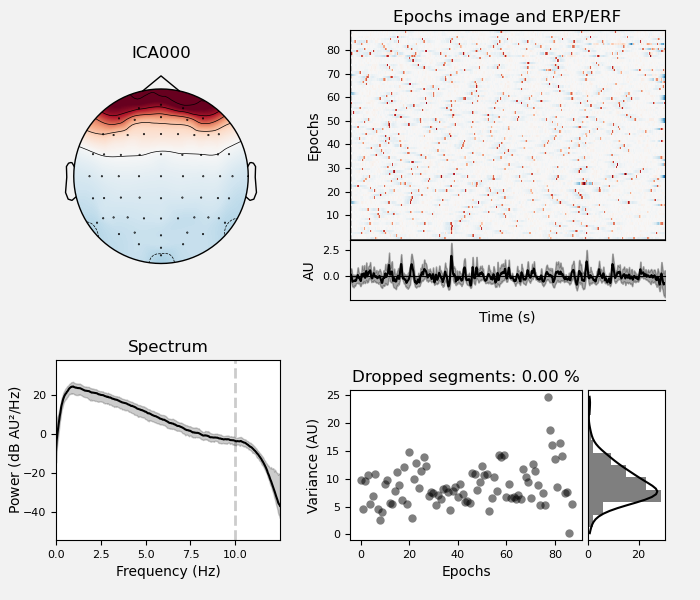

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


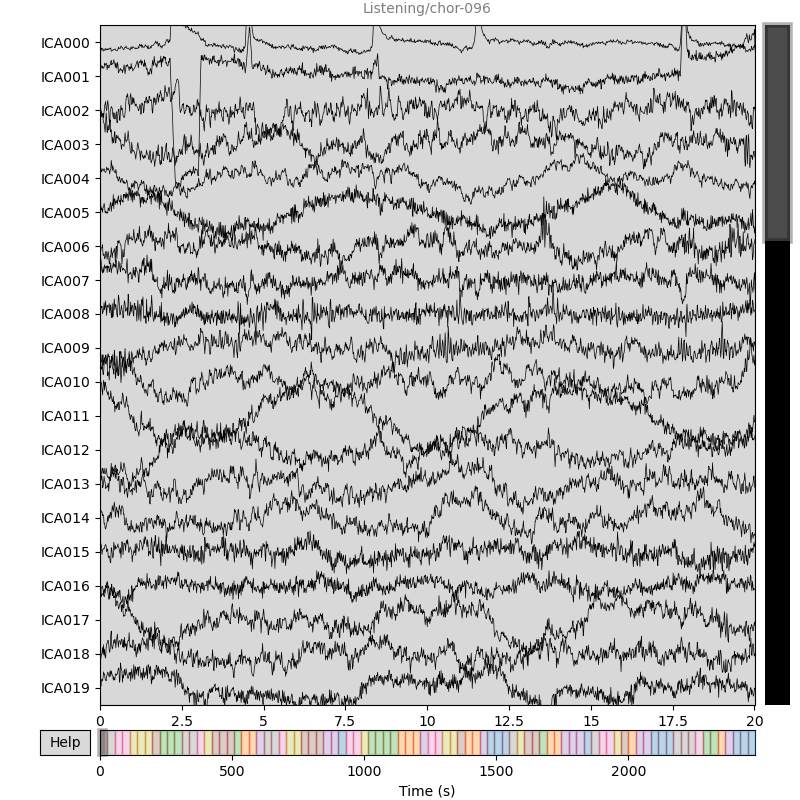

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


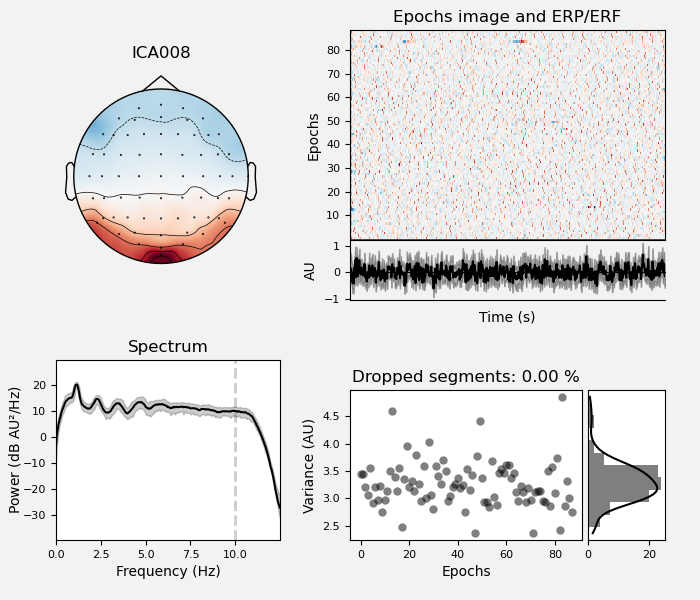

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


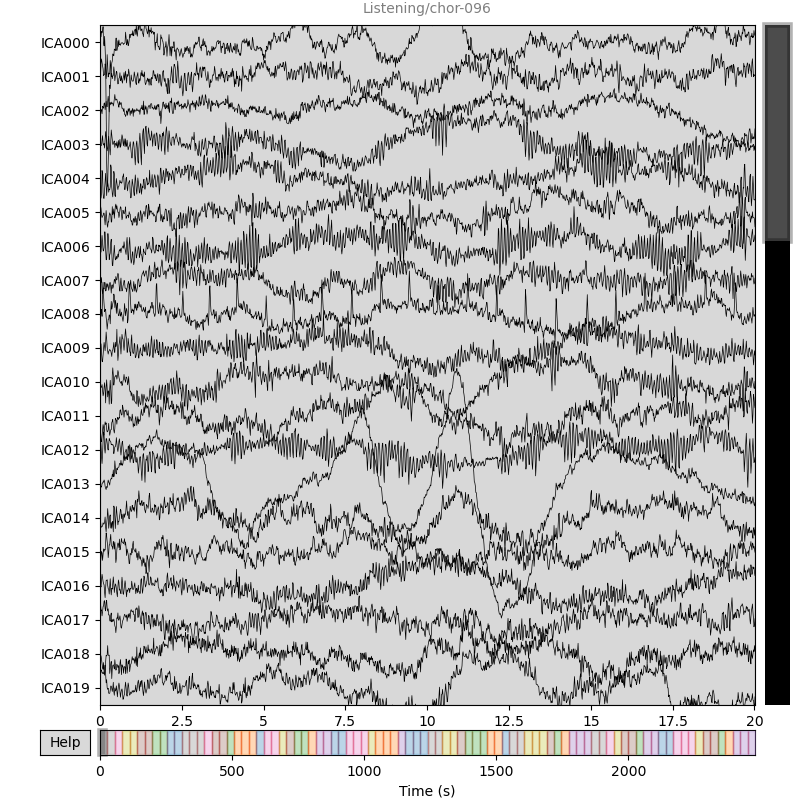

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


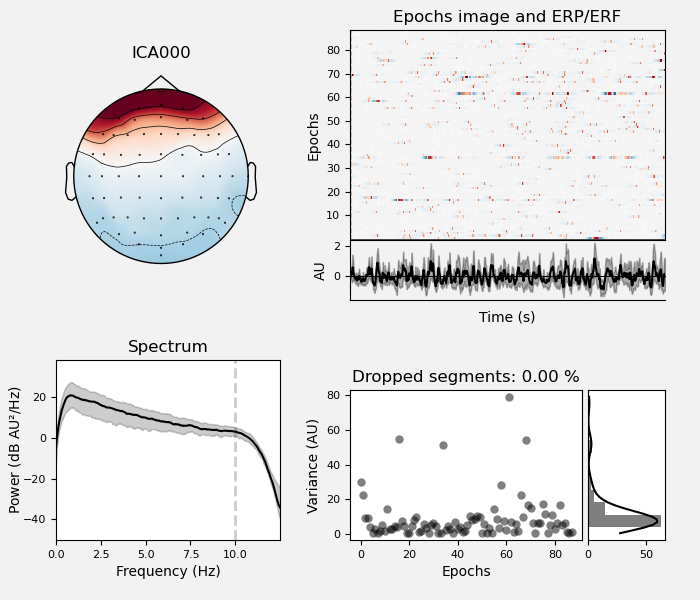

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


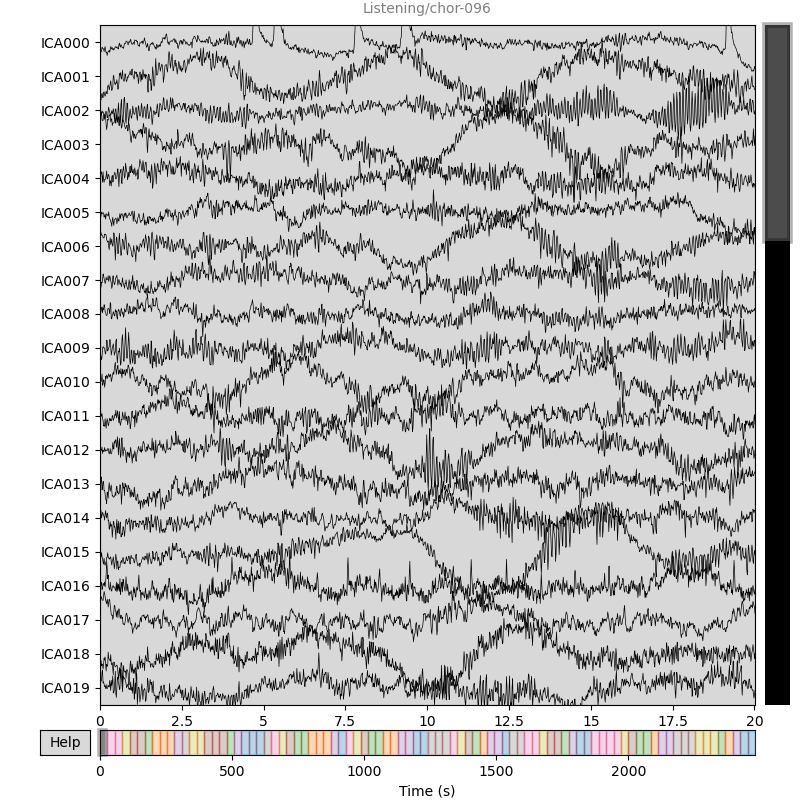

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


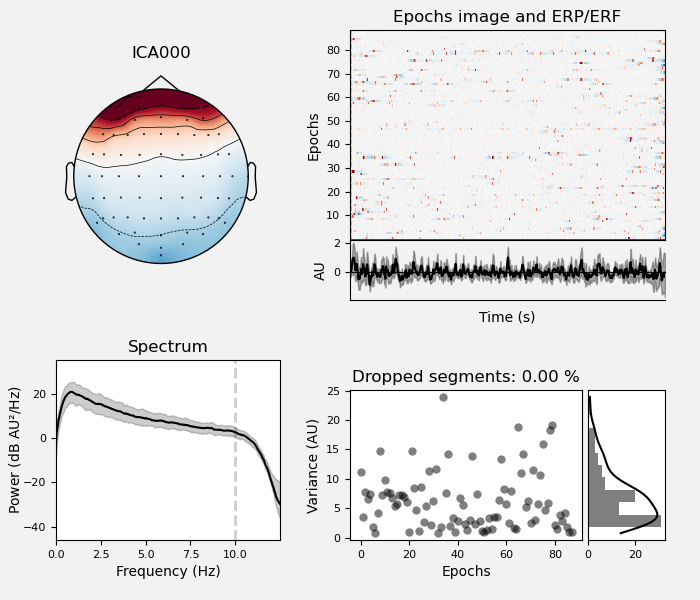

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


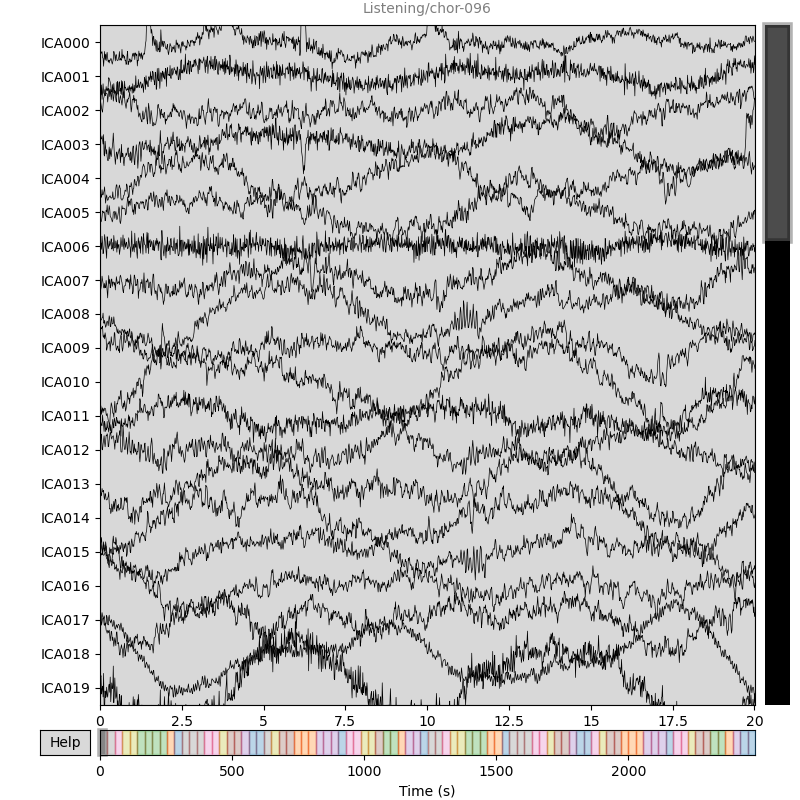

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


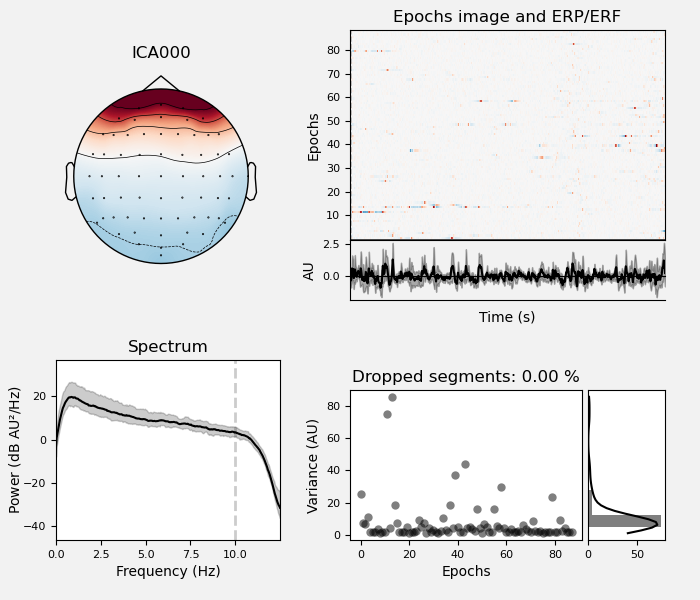

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


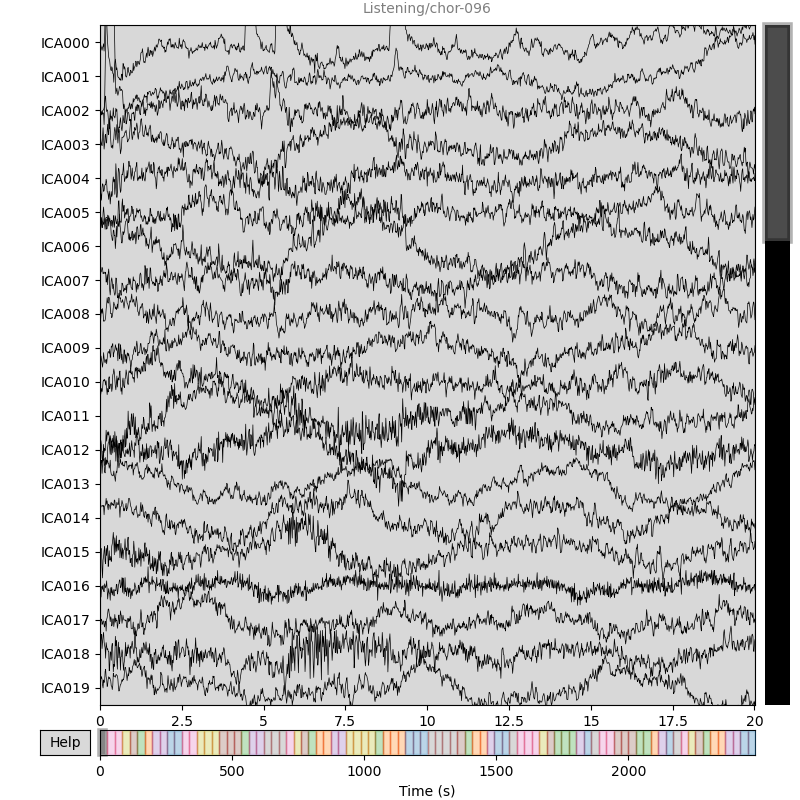

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


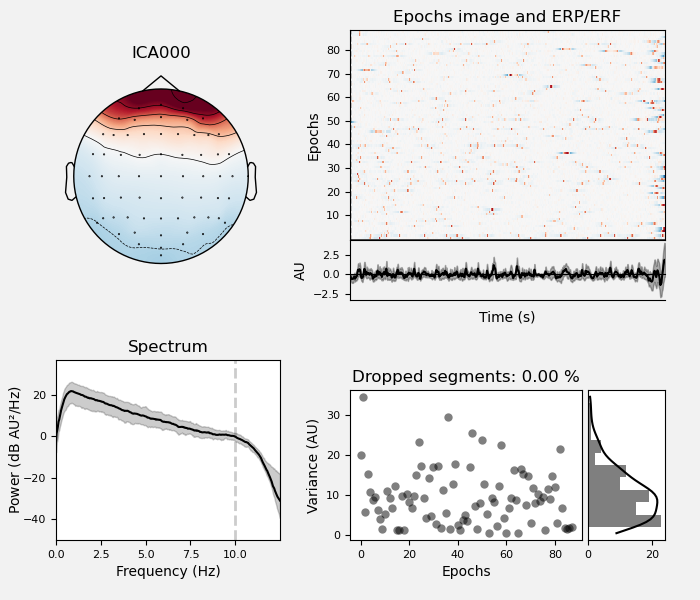

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


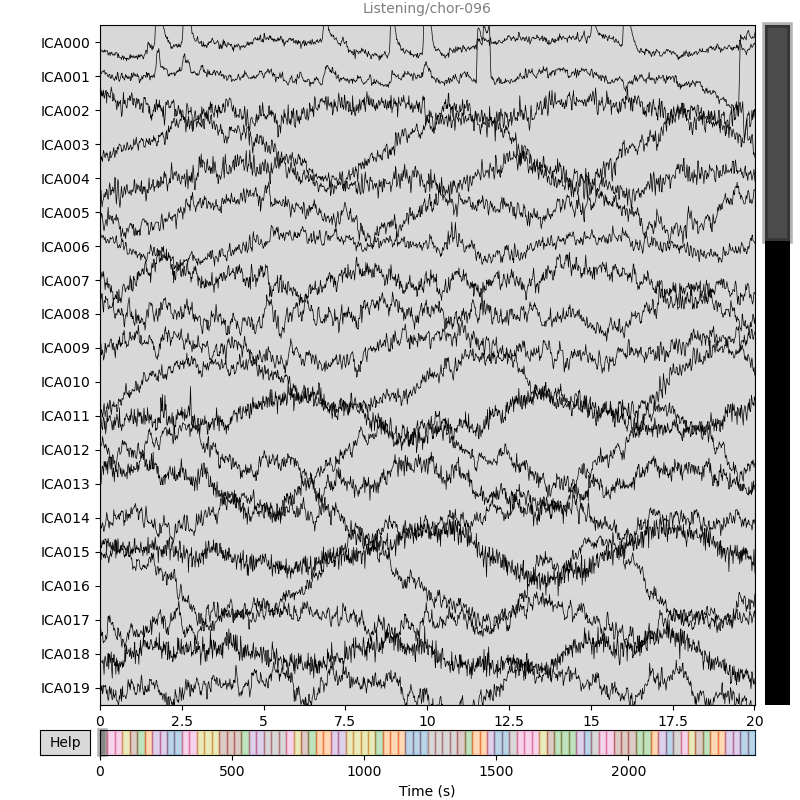

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


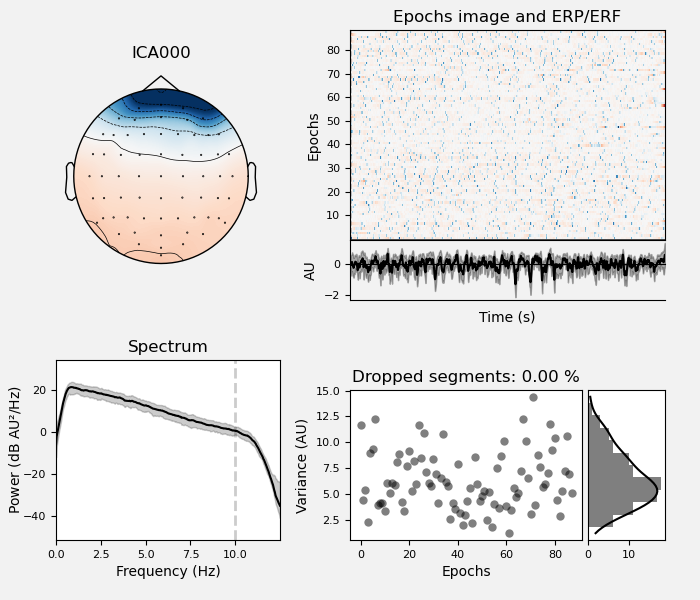

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


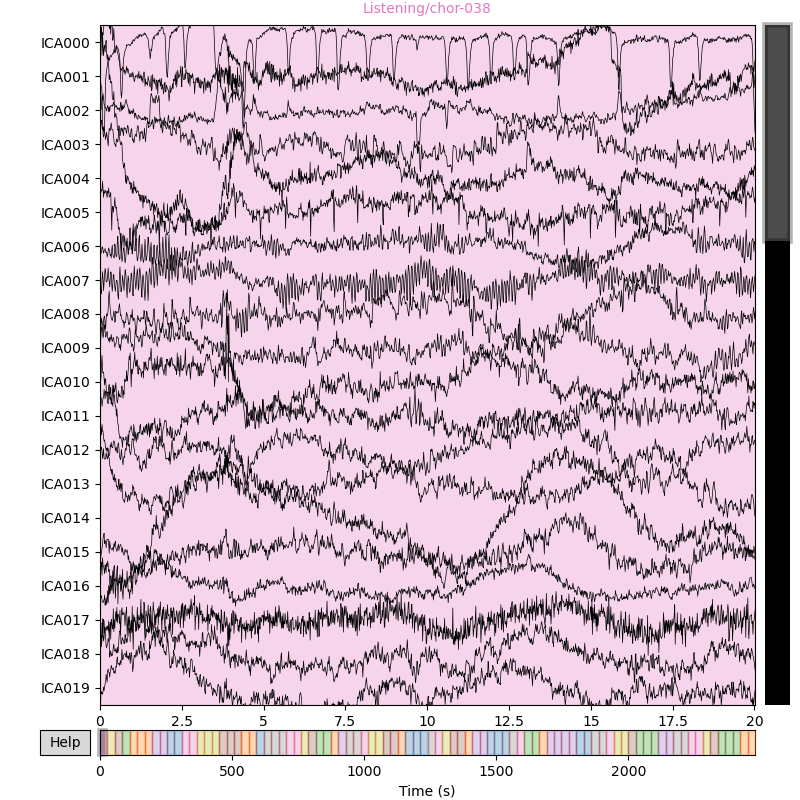

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


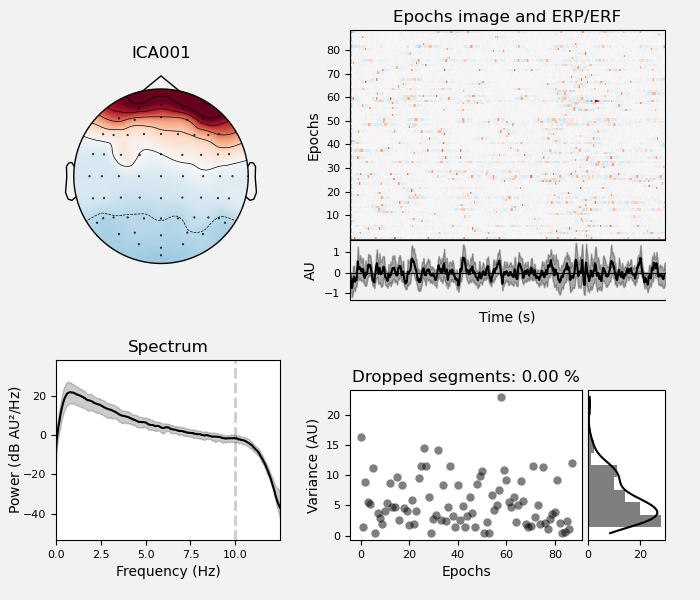

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


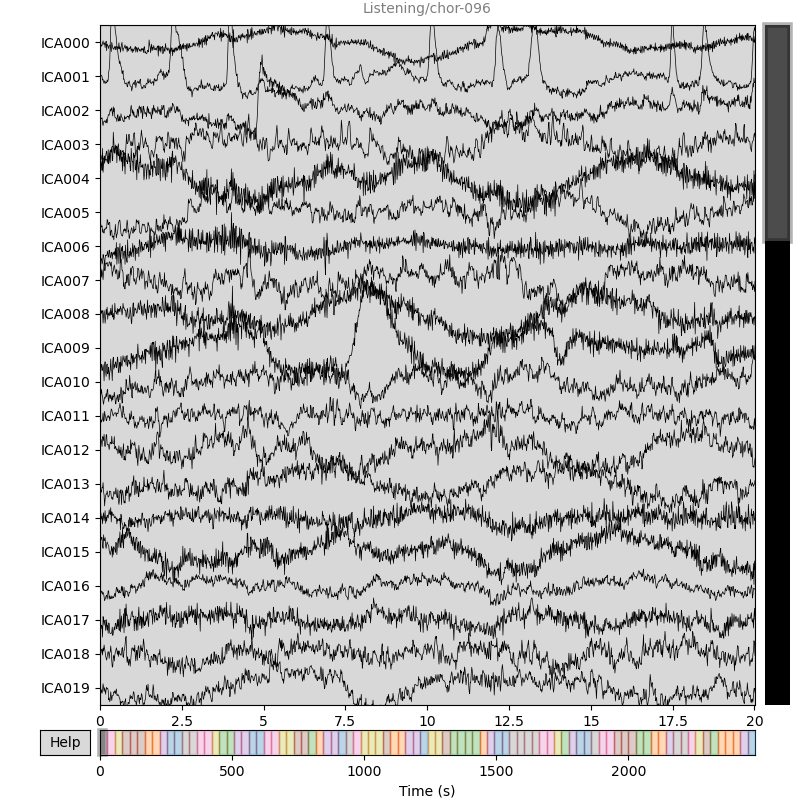

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


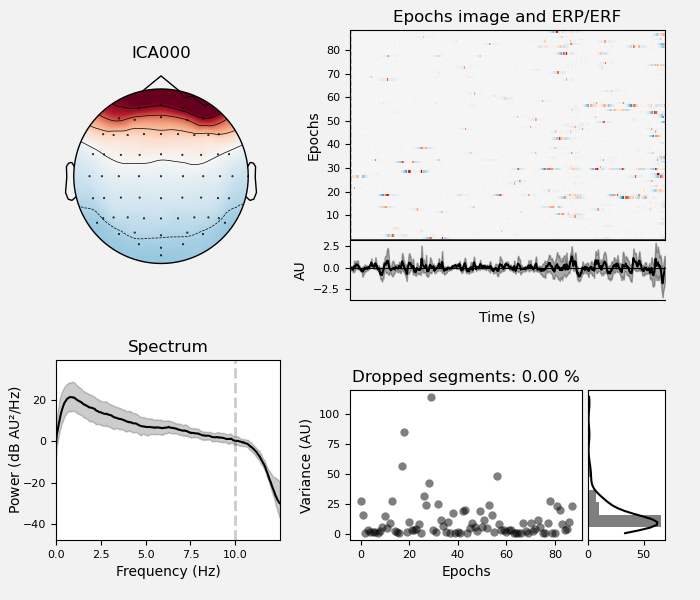

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


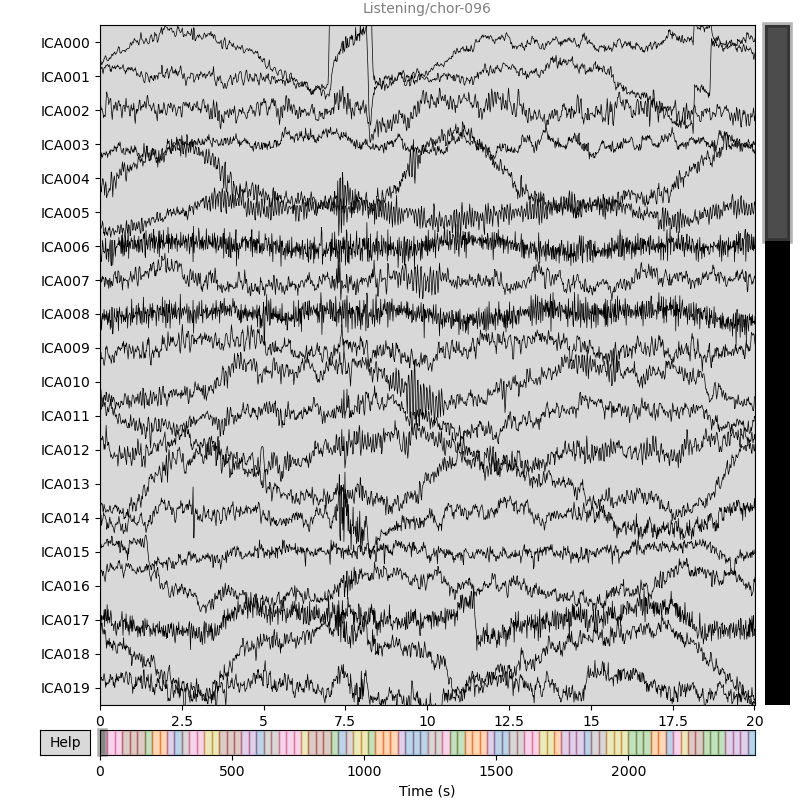

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


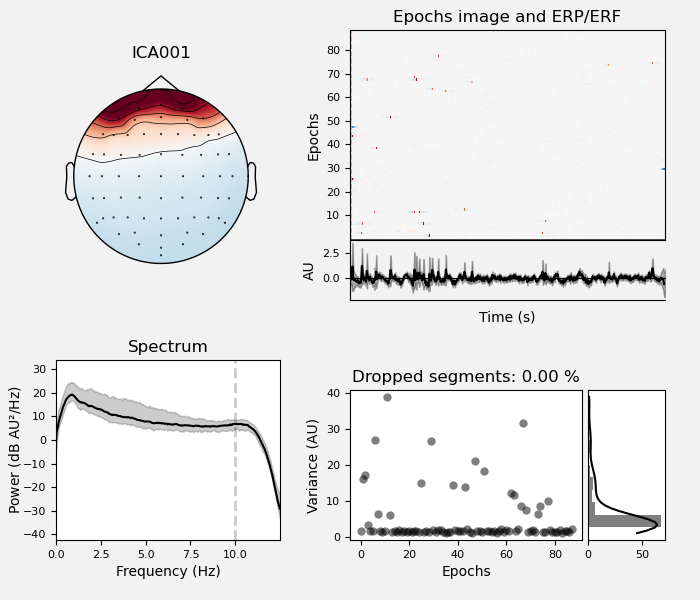

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


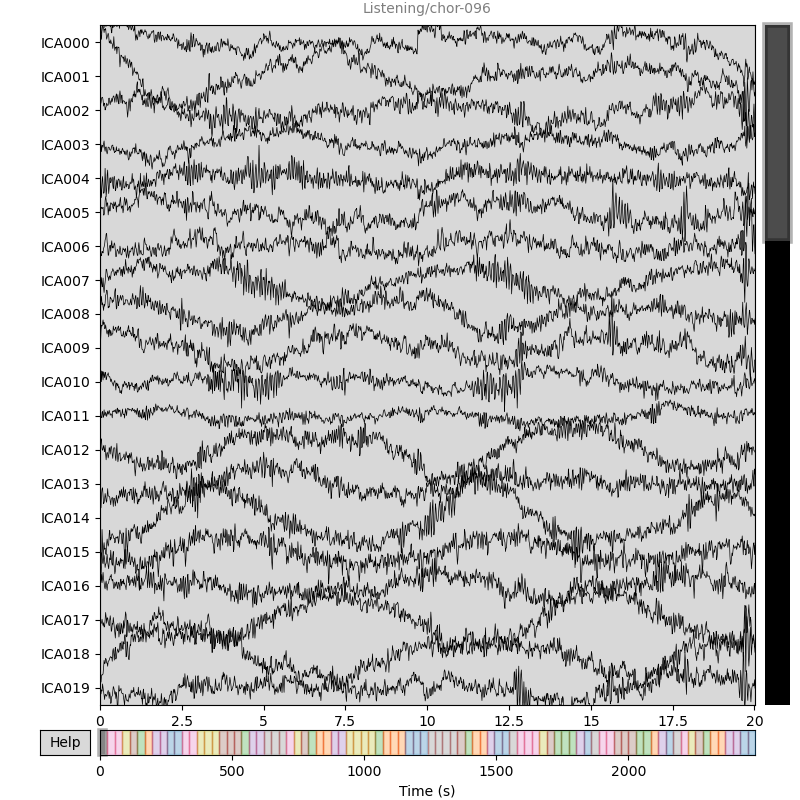

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


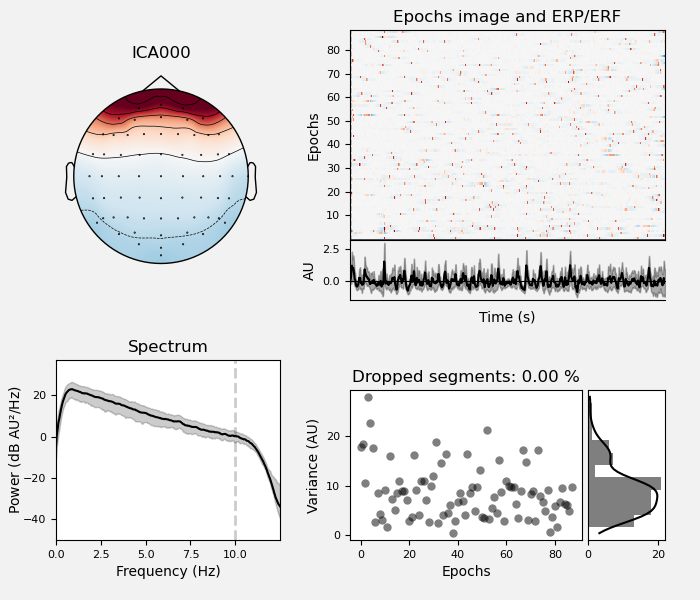

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


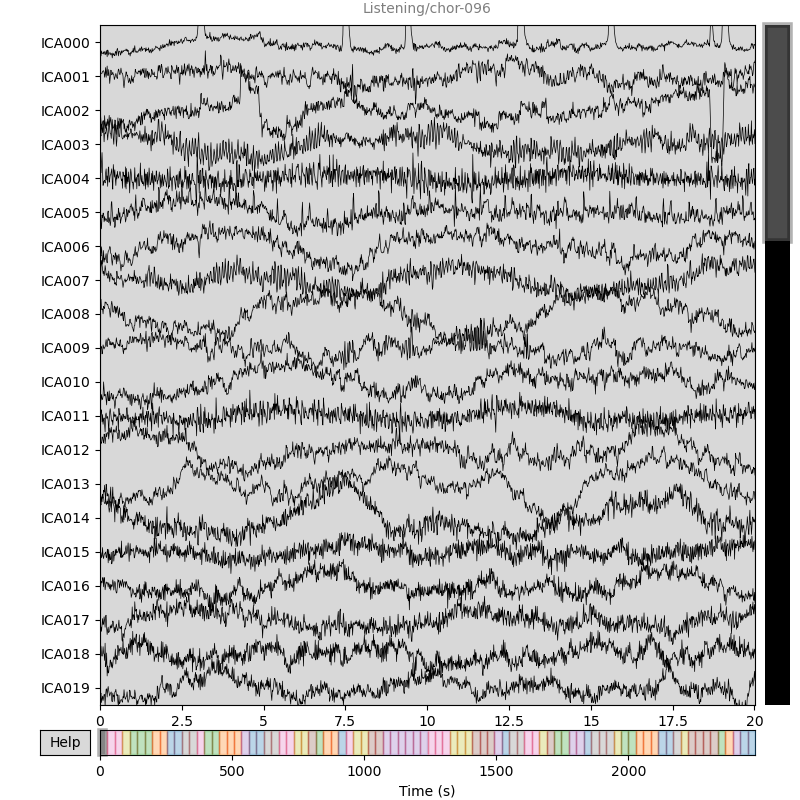

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


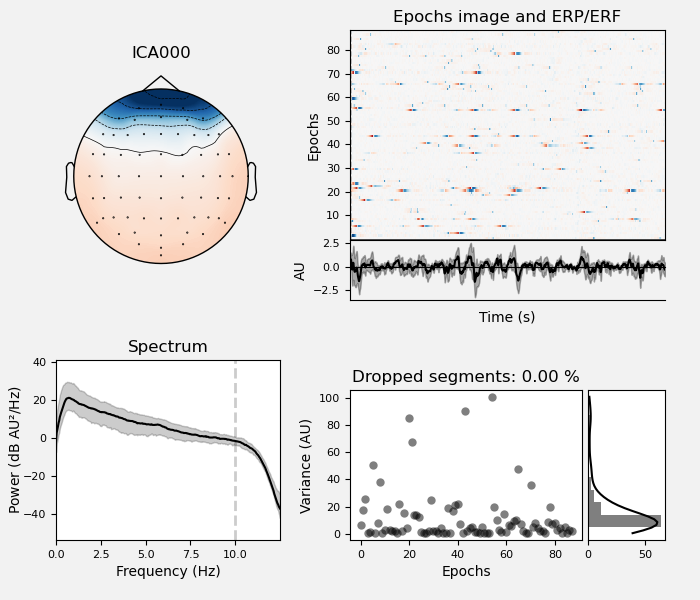

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


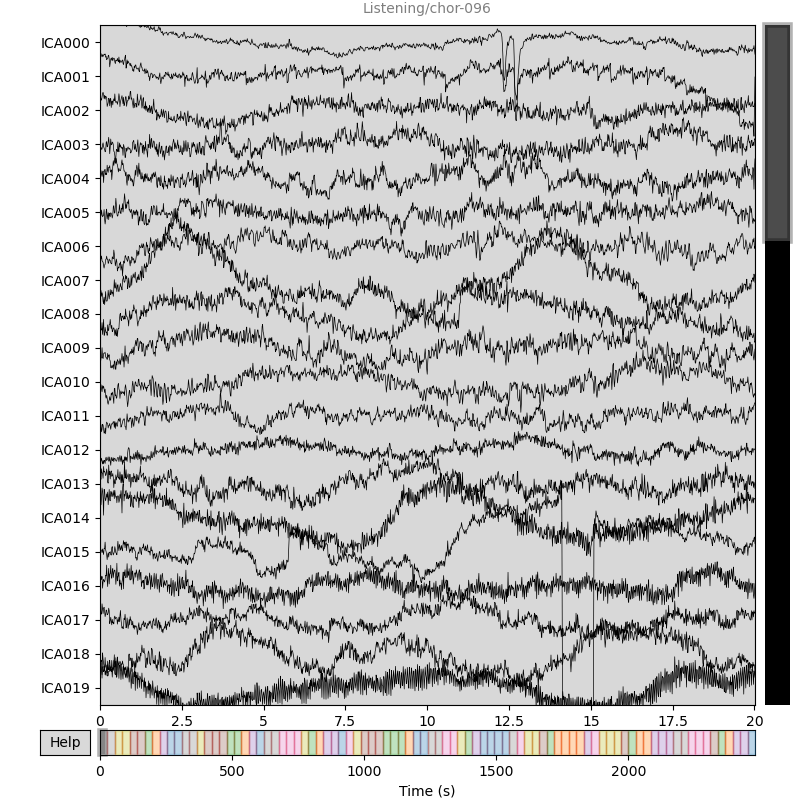

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


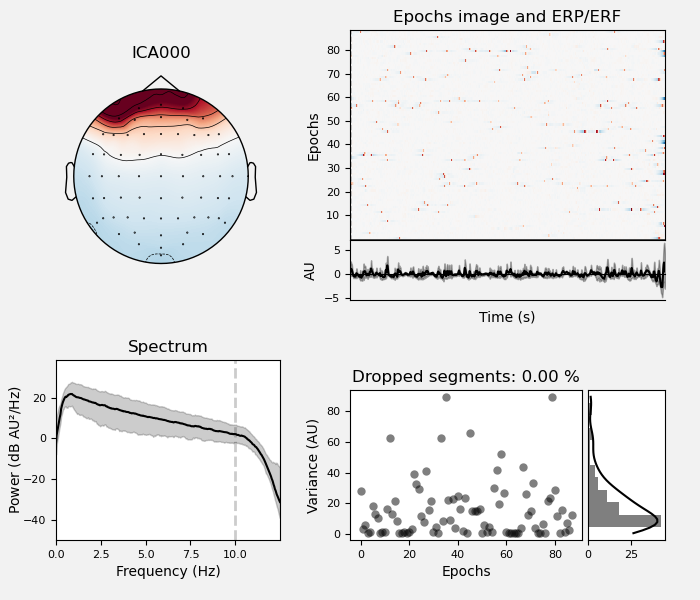

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


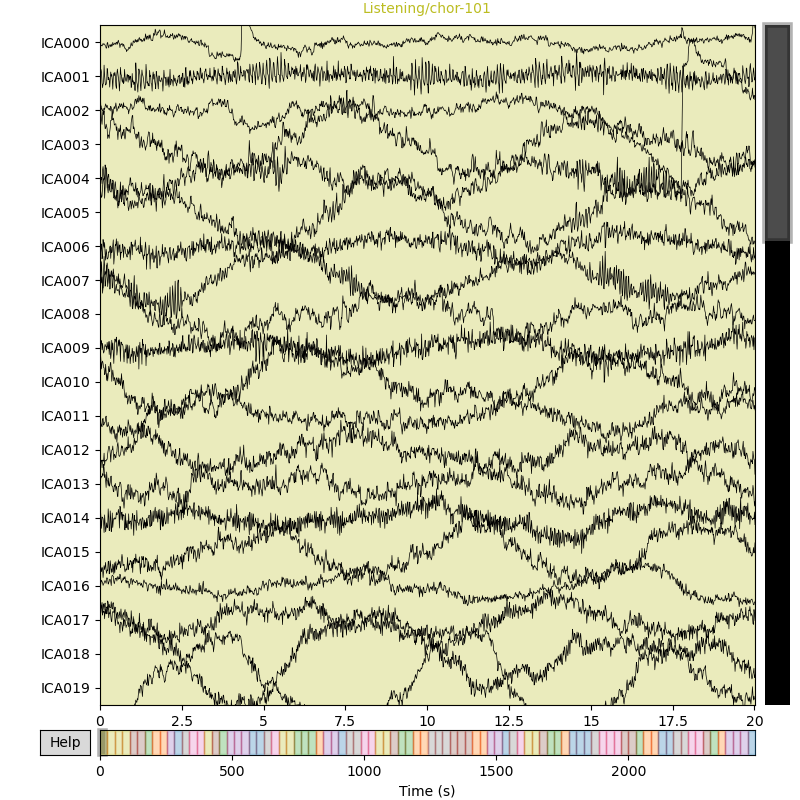

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


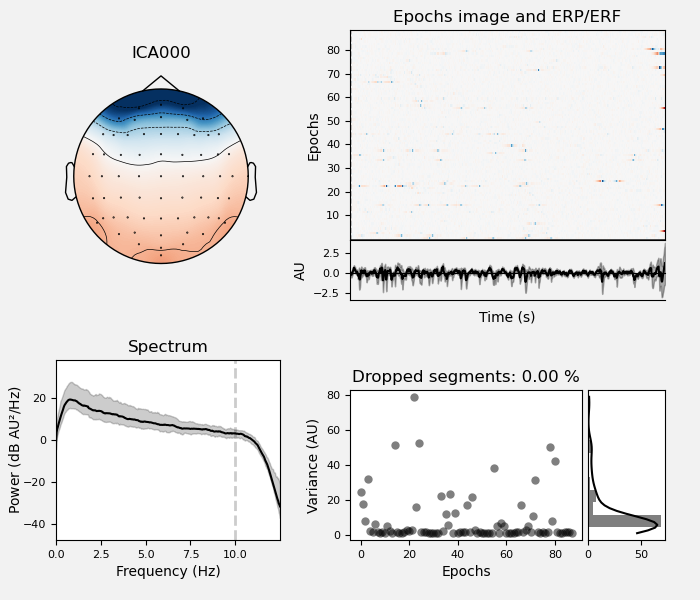

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


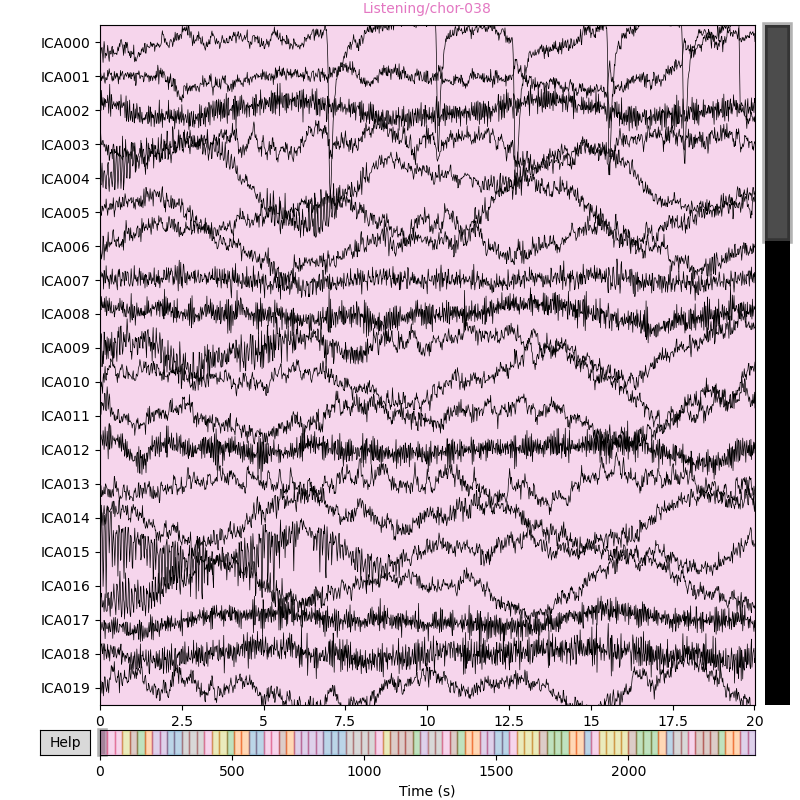

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


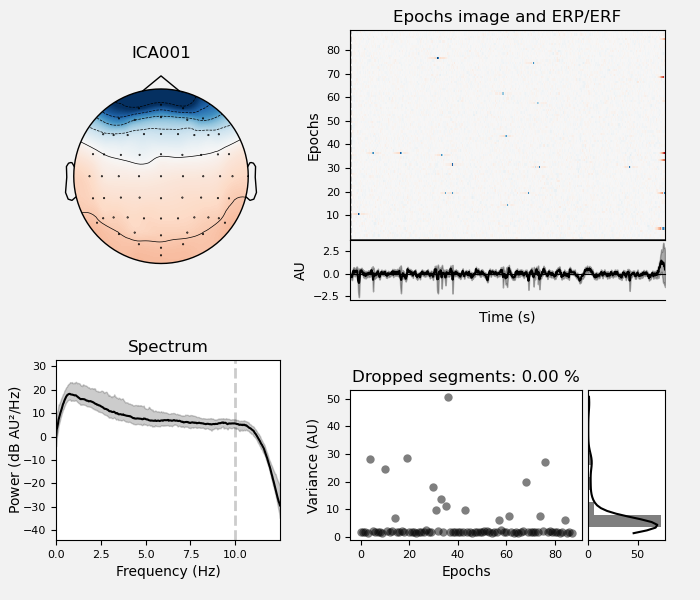

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


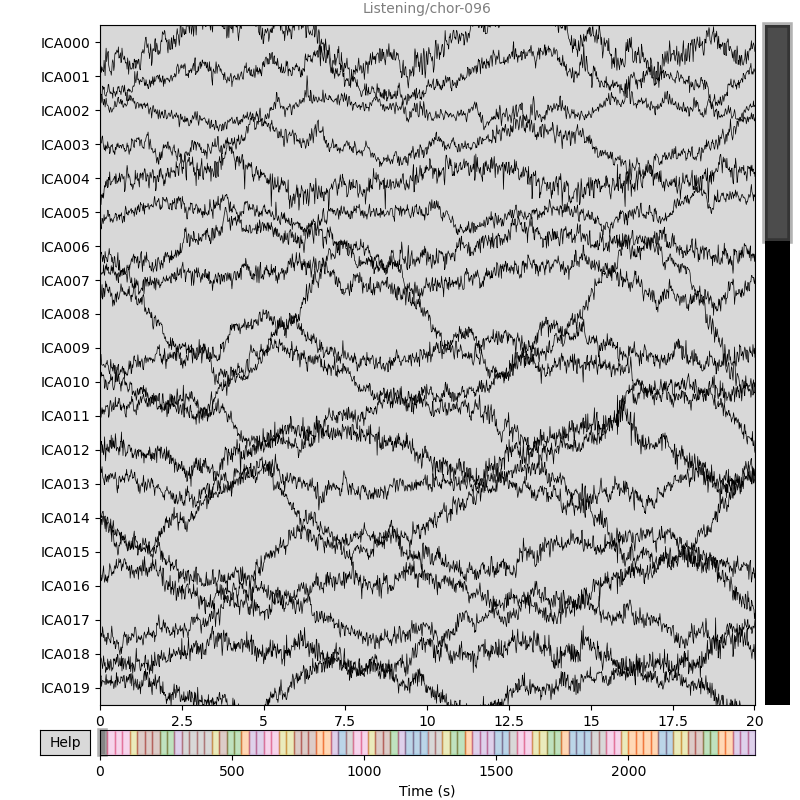

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


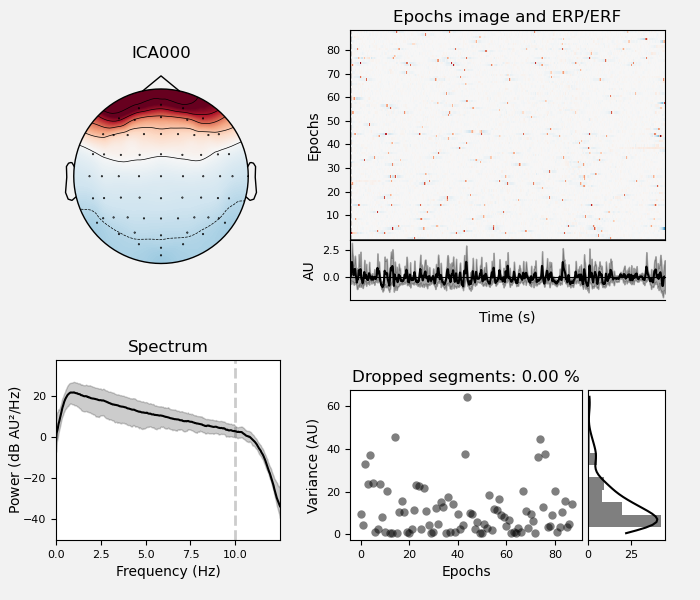

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


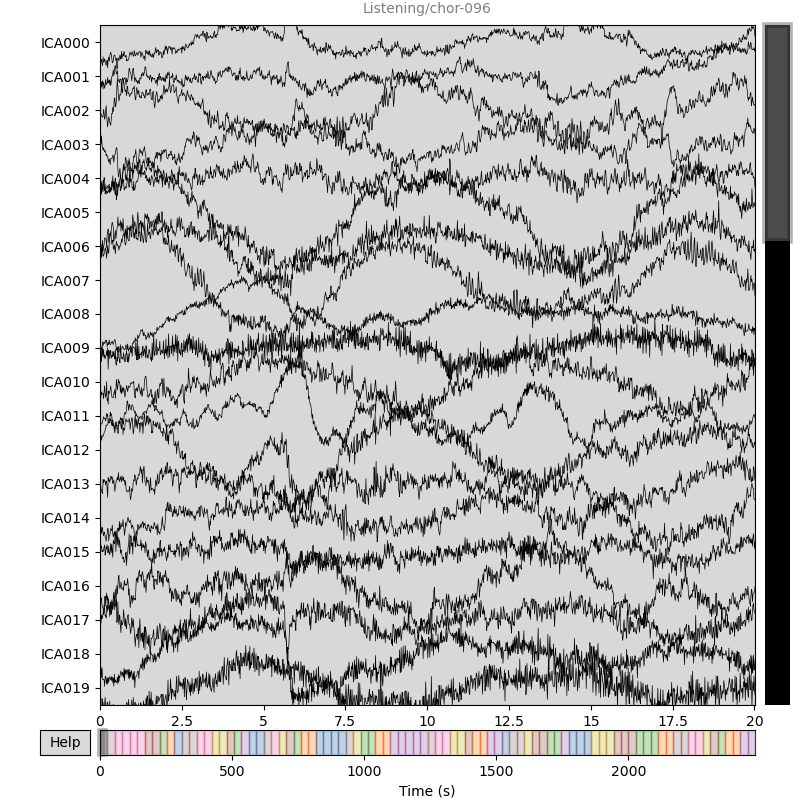

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


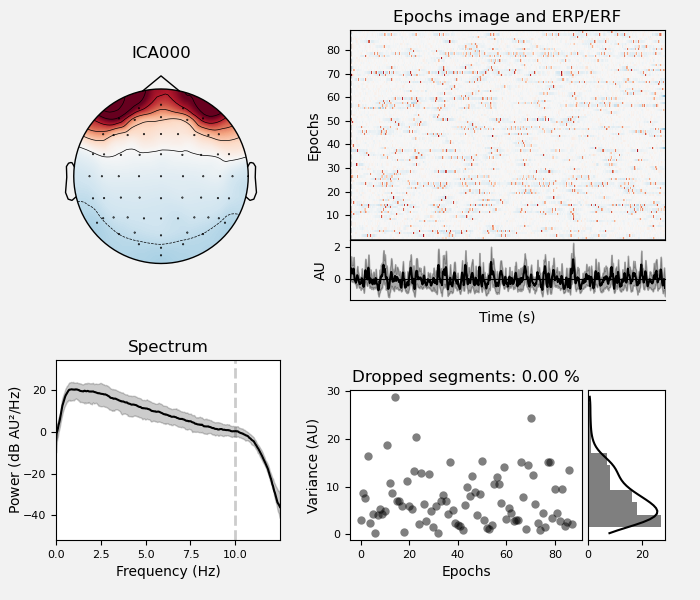

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


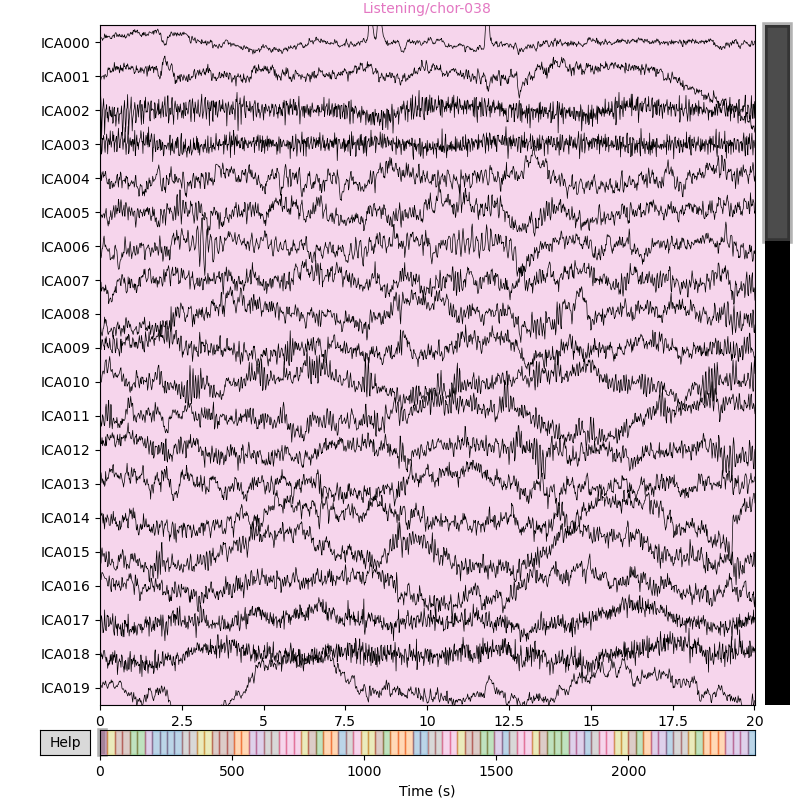

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


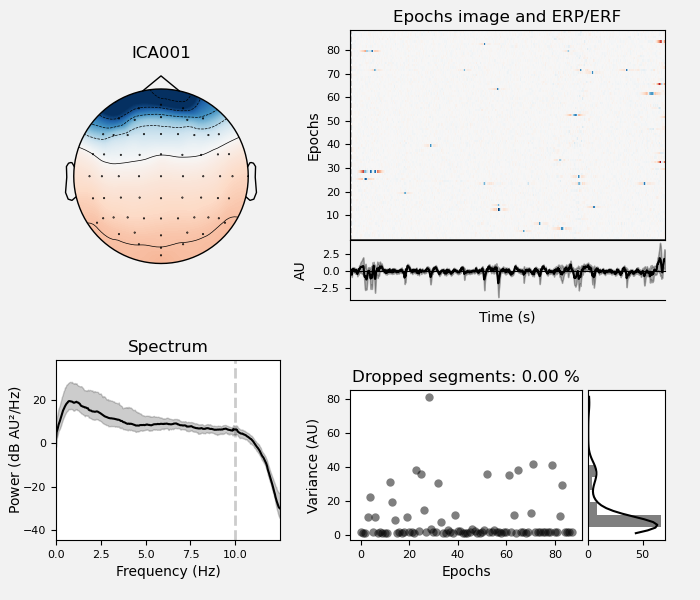

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


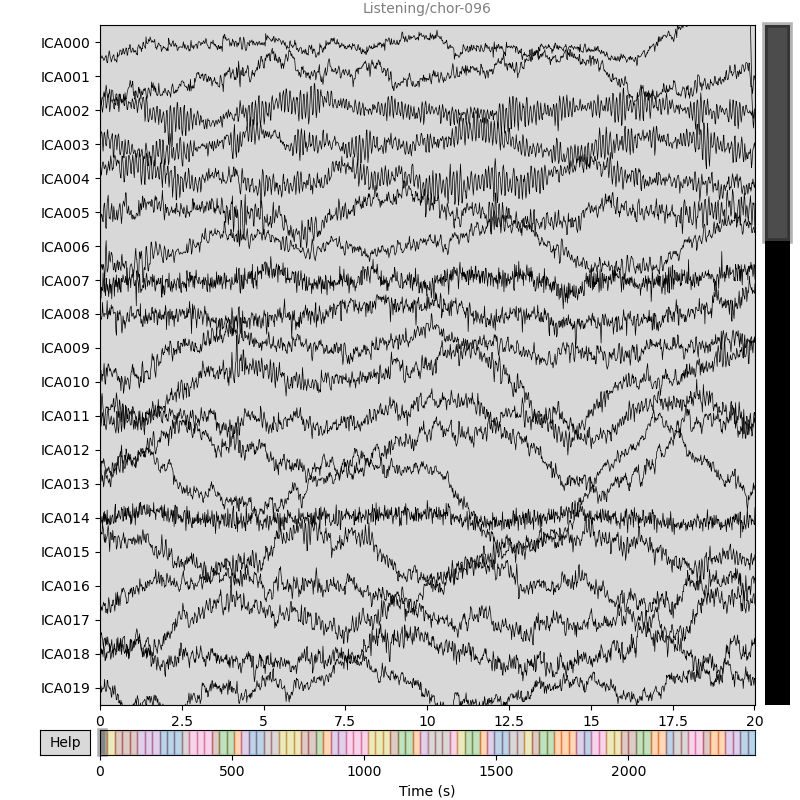

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


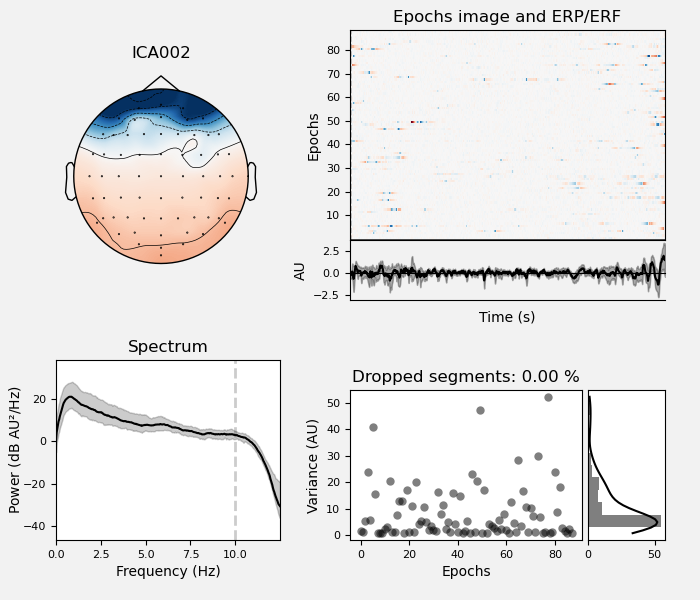

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


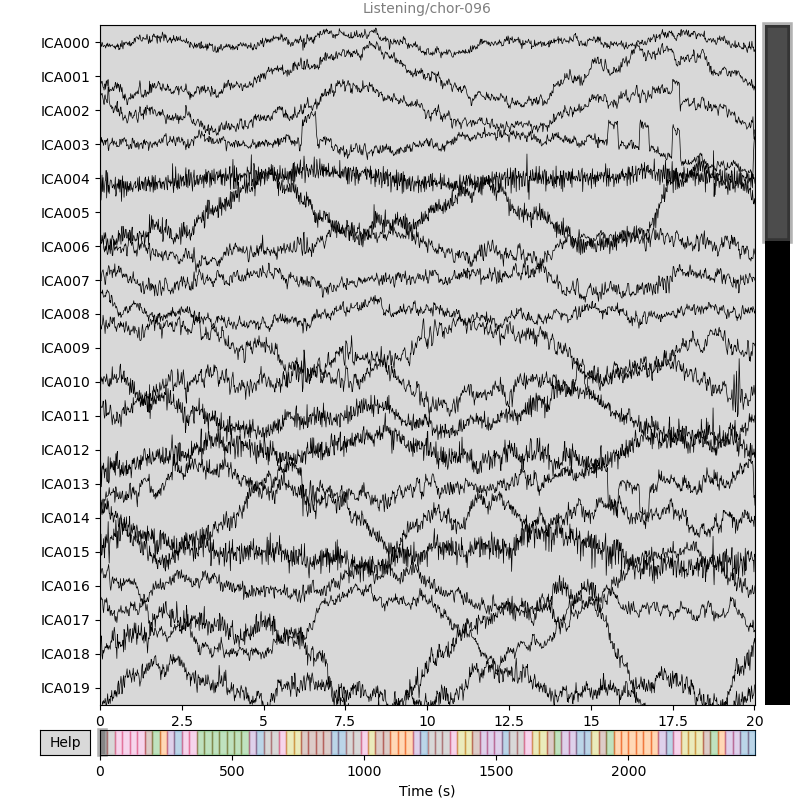

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


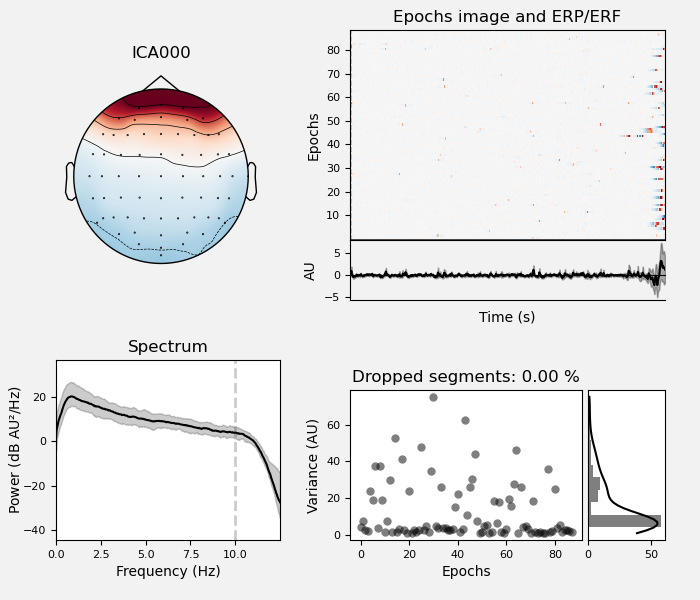

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


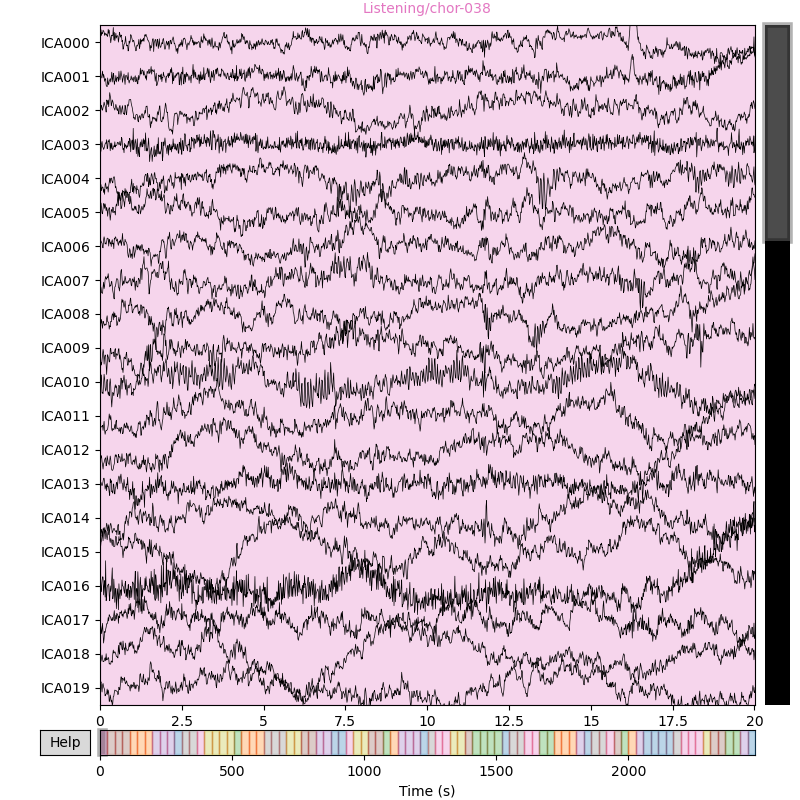

Used Annotations descriptions: ['Imagery/chor-019', 'Imagery/chor-038', 'Imagery/chor-096', 'Imagery/chor-101', 'Listening/chor-019', 'Listening/chor-038', 'Listening/chor-096', 'Listening/chor-101']
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 88 events and 1793 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
88 matching events found
No baseline correction applied
0 projection items activated


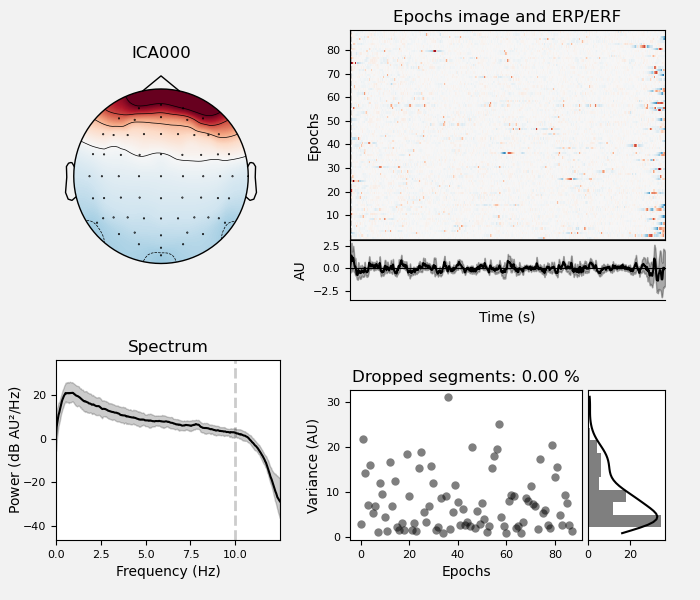

Creating RawArray with float64 data, n_channels=63, n_times=158664
    Range : 0 ... 158663 =      0.000 ...  2479.109 secs
Ready.


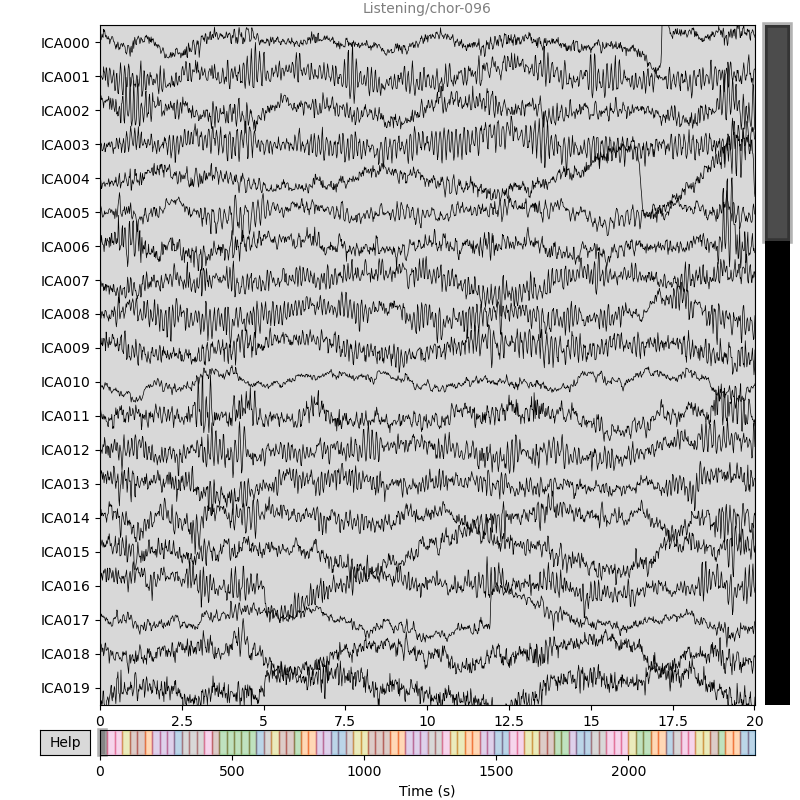

In [41]:
# Manually identified blink ICA sources
blink_ica_source_idx = {}
blink_ica_source_idx[1] = 0
blink_ica_source_idx[2] = 8 # doesn't blink much?
blink_ica_source_idx[3] = 0
blink_ica_source_idx[4] = 0
blink_ica_source_idx[5] = 0
blink_ica_source_idx[6] = 0
blink_ica_source_idx[7] = 0
blink_ica_source_idx[8] = 1
blink_ica_source_idx[9] = 0 #35
blink_ica_source_idx[10] = 1
blink_ica_source_idx[11] = 0
blink_ica_source_idx[12] = 0
blink_ica_source_idx[13] = 0
blink_ica_source_idx[14] = 0
blink_ica_source_idx[15] = 1
blink_ica_source_idx[16] = 0
blink_ica_source_idx[17] = 0
blink_ica_source_idx[18] = 1
blink_ica_source_idx[19] = 2
blink_ica_source_idx[20] = 0
blink_ica_source_idx[21] = 0

subjectIDs = icas.keys()

plot_ica_properties(
    subjectIDs,
    icas,
    eog_indices,
    blink_ica_source_idx = blink_ica_source_idx,
    bpf_filter = True,
    bpf_l_freq = 1,
    bpf_h_freq = 10,
    ICA_PICKS_TO_PLOT = [0, 1, 2, 3, 4],
    verbose = 'ERROR',
)

Now with blink ICA sources identified, prepare to export eog_events:

In [55]:
def get_blink_events(
    subjectIDs,
    icas,
    blink_ica_source_idx = [], # assume top component is blinks (use the top eog scoring ICA component)
    eog_l_freq = 1,
    eog_h_freq = 10,
    verbose = 'ERROR',
):
    eog_peaks = {}

    for subjectID in subjectIDs:
        eog_peaks[subjectID] = {}

        raw = merged_raws_for_subject(subjectID) #merged_raw_trials[subjectID]
        trial_annots = raw.annotations.copy()
            
        ica = icas[subjectID]
        if blink_ica_source_idx == []: # assume 0th IC (top component) is blinks (NOT true across subjects!)
            eog_src = ica.get_sources(raw)[0]
        else:
            eog_src = ica.get_sources(raw)[blink_ica_source_idx[subjectID]]

        # Find EOG events from target EOG IC
        ica_eog_event_id = 3
        ica_eog_events = mne.preprocessing.ica_find_eog_events(
            raw,
            eog_source = eog_src[0][0],
            event_id = ica_eog_event_id,
            l_freq = eog_l_freq,
            h_freq = eog_h_freq,
            verbose = 'ERROR',
        )

        eog_peaks[subjectID]['ica_eog_events'] = ica_eog_events[:, 0]
        eog_peaks[subjectID]['source'] = eog_src[0][0]
        eog_peaks[subjectID]['trial_annots'] = trial_annots
        eog_peaks[subjectID]['ica'] = ica
    
    return eog_peaks

In [57]:
LOAD_SAVED_DATA = False
SAVE_EOG_PEAKS = True

#subjectIDs = [9] #range(1, 21+1)
for subjectID in subjectIDs: # export one subject's data at a time
    
    if LOAD_SAVED_DATA:
        eog_peaks = np.load(
            f'../../data/eog_peaks/merged_raws/eog_peaks_sub{subjectID}_merged_raws.npy', 
            allow_pickle=True,
        )
        eog_peaks = eog_peaks.flat[0]
        
    else: # This step takes 15 mins!
        eog_peaks = get_blink_events(
            [subjectID],
            icas,
            blink_ica_source_idx,
            eog_l_freq = 1,
            eog_h_freq = 10,
            verbose = 'ERROR',
        )
        
        if SAVE_EOG_PEAKS:
            np.save(
                file = f'../../data/eog_peaks/merged_raws/eog_peaks_sub{subjectID}_merged_raws.npy', 
                arr = eog_peaks,
            )

In [58]:
eog_peaks.keys()

dict_keys([21])

Total number of blinks across trials:

In [59]:
eog_peaks[21]['ica_eog_events'].shape

(158,)

Plot top IC (highest EOG score) for all subjects, conditions, songs, and trials

[ 0.08385287  0.03254682  0.03577399 ... -0.02485896 -0.0409438
 -0.07481356]
[ 0.002029    0.04373935  0.02243806 ... -0.15135447 -0.14497807
 -0.12890053]
[0.35952354 0.36160647 0.34314062 ... 0.9458323  0.93124993 1.        ]
[ 0.00898988 -0.02799689 -0.07227851 ... -0.25829947 -0.33553799
 -0.34261222]
[-0.03618338 -0.08409526 -0.06452842 ...  0.80612594  0.73148707
  0.71982645]
[ 0.1106937   0.10508177  0.11543989 ... -0.33137686 -0.34464424
 -0.30933811]
[-0.11425591 -0.12272261 -0.10285767 ...  0.9426882   0.91936724
  0.86043073]
[-0.20921657 -0.25747977 -0.32389504 ...  0.37935099  0.39988816
  0.34234617]
[-0.18122653 -0.17262891 -0.15462479 ...  0.10285895  0.11565281
  0.12554702]
[-0.01707549 -0.01022268 -0.01329595 ...  0.9224998   0.97965737
  1.        ]
[-0.26974118 -0.17452105 -0.23366369 ...  0.04885793  0.0517396
 -0.00904529]
[0.10891655 0.11985649 0.14866051 ... 0.96616041 1.         0.98604415]
[-0.08891641 -0.10231724 -0.07760228 ... -0.05886814 -0.06253535
 -0

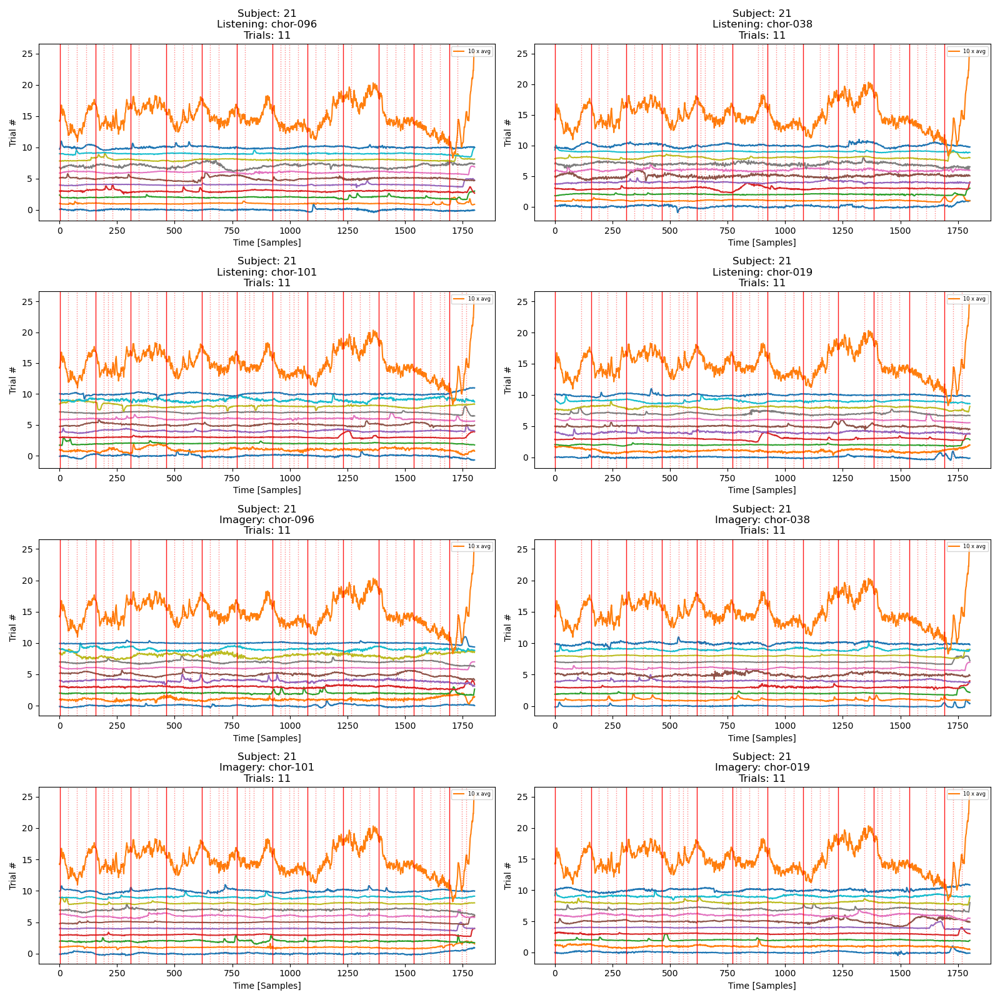

In [62]:
AVG_SCALE = 10
AVG_OFFSET = 15

for subjectID in eog_peaks:

    # Make a new figure per subject, song, and condition 
    plt.figure(figsize=(16, 16))

    t = np.arange(start=0, stop=1803, step=1, dtype='float64')

    # Container for collecting average across trials
    src_avg = [np.zeros_like(t)]*8
    N_avg = 11 #len(eog_peaks[subjectID])
    
    trialOffset = [0]*8

    # Plot eog_source traces for each subject, trial
    for trialIdx in range(88):

        eog_source = eog_peaks[subjectID]['source'][trialIdx*1803:(trialIdx+1)*1803]
        print(eog_source)

        max_peak = np.max(eog_source)
        min_peak = np.min(eog_source)
        if np.abs(min_peak) > np.abs(max_peak):
            eog_source /= min_peak # normalize, flip polarity
        else:
            eog_source /= max_peak # normalize

        stimIdx = stimIdxs[trialIdx]
        condIdx = condIdxs[trialIdx]

        pltIdx = 4*(condIdx-1) + stimIdx

        # Plot Fp1 data for these trials
        plt.subplot(4, 2, pltIdx)

        # Plot and add an offset for each trial
        plt.plot(eog_source + trialOffset[pltIdx-1]) # chan0 is FP1

        # Average
        src_avg[pltIdx-1] += eog_source / N_avg

        trialOffset[pltIdx-1] += 1
            
    # Also plot notes/beats and add titles
    for stimIdx in [1, 2, 3, 4]: # ordering of stim doesn't matter for plotIdx
        stimLabel = stimId_to_Song_map[stimIdx]
        notes = t[stim[stimLabel]['notes']]
        beats = t[stim[stimLabel]['beats']>0]

        for condIdx in [1, 2]:
            condLabel = condId_to_State_map[condIdx]

            pltIdx = 4*(condIdx-1) + stimIdx

            # Plot Fp1 data for these trials
            plt.subplot(4, 2, pltIdx)

            # Plot the average
            plt.plot(AVG_SCALE * src_avg[pltIdx-1] + AVG_OFFSET, 
                     label=f'{AVG_SCALE} x avg')

            # draw beat/note onsets
            for note in notes:
                plt.axvline(x=note, c='r', linewidth=1, alpha=0.5, linestyle=':')
            for beat in beats:
                plt.axvline(x=beat, c='r', linewidth=1, alpha=0.9) #0 * t_bar[beats_bar], '*')

            title_str = '' #'='*50 + '\n'
            title_str += f'Subject: {subjectID}\n'
            title_str += f'{condLabel}: {stimLabel}\n'
            title_str += f'Trials: {N_avg}'
            plt.title(title_str)

            plt.xlabel('Time [Samples]')
            plt.ylabel('Trial #')
            plt.legend(loc='upper right', prop={'size': 6}) #, bbox_to_anchor=[1.5, 0.5])
            #print(title_str)

            pltIdx += 1

    plt.tight_layout()
plt.show()